In [1]:
# pip install PIL numpy pandas os random cv2 fpdf 

In [2]:
import numpy as np
import pandas as pd
import os
import random
import cv2
from fpdf import FPDF
from PIL import Image
from os.path import isfile, join
from IPython.display import display
from PIL import Image as pili, ImageDraw as pild, ImageFont as pilf, ImageOps as piliops

# Image Compression Function

This Python code defines a function `imgcompress` for compressing images using OpenCV library. The function takes three parameters:
- `path_in`: The file path of the input image.
- `path_out`: The file path where the compressed image will be saved.
- `k`: The scaling factor by which the image will be resized. A value of 1 will keep the original size, while values less than 1 will shrink the image.

## Function Description
The `imgcompress` function performs the following steps:

1. **Read Input Image**: Reads the input image using OpenCV (`cv2.imread`).
2. **Calculate Resized Dimensions**: Calculates the dimensions of the resized image based on the scaling factor `k`.
3. **Resize Image**: Resizes the input image using OpenCV's `resize` function (`cv2.resize`).
4. **Save Resized Image**: Saves the resized image to the specified output path (`cv2.imwrite`).
5. **Display Result**: Displays the compressed image using IPython's `display` function after converting it to PIL format.

The function utilizes the Python Imaging Library (PIL) for image display and OpenCV library for image manipulation.

In [3]:
from PIL import Image
import cv2 
from IPython.display import display

def imgcompress(path_in, path_out, k):
    """
    Compresses an image by resizing it with a given scaling factor.

    Args:
        path_in (str): The file path of the input image.
        path_out (str): The file path where the compressed image will be saved.
        k (float): The scaling factor by which the image will be resized. 
            A value of 1 will keep the original size, while values less than 1 will shrink the image.

    Returns:
        None
    """
    # Read the input image using OpenCV
    img = cv2.imread(path_in, cv2.IMREAD_UNCHANGED)

    # Calculate the dimensions of the resized image
    width = int(img.shape[1] / k)
    height = int(img.shape[0] / k)

    # Resize the image using OpenCV's resize() function
    scaled = cv2.resize(img, (width, height), interpolation=cv2.INTER_AREA)

    # Save the resized image
    cv2.imwrite(path_out, scaled)
    
    # Display the compressed image using IPython.display
    imgc = cv2.imread(path_out, cv2.IMREAD_UNCHANGED)
    imgc_pil = cv2.cvtColor(imgc, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    display(Image.fromarray(imgc_pil))

# Image Compression Function (In-Memory)

This Python function `imgcompress_mem` is designed to compress images in-memory without saving them to disk. It takes two parameters:
- `path_in`: The file path of the input image.
- `k`: The scaling factor by which the image will be resized. A value of 1 will keep the original size, while values less than 1 will shrink the image.

## Function Description
The `imgcompress_mem` function performs the following steps:

1. **Read Input Image**: Reads the input image specified by `path_in` using OpenCV's `cv2.imread` function.
2. **Calculate Resized Dimensions**: Calculates the dimensions of the resized image based on the compression factor `k`.
3. **Resize Image**: Resizes the input image using OpenCV's `resize` function (`cv2.resize`), based on the calculated dimensions.
4. **Return Resized Image**: Returns the resized image array without saving it to disk.

This function is useful for scenarios where image compression is needed for in-memory operations, such as image processing pipelines or real-time applications.

In [4]:
def imgcompress_mem(path_in, k):
    """
    Compresses an image in memory by resizing it with a given scaling factor.

    Args:
        path_in (str): The file path of the input image.
        k (float): The scaling factor by which the image will be resized. 
            A value of 1 will keep the original size, while values less than 1 will shrink the image.

    Returns:
        numpy.ndarray: The resized image array.
    """
    # Read the input image using OpenCV
    img = cv2.imread(path_in, cv2.IMREAD_UNCHANGED)

    # Calculate the dimensions of the resized image
    width = int(img.shape[1] / k)
    height = int(img.shape[0] / k)

    # Resize the image using OpenCV's resize() function
    resized_img = cv2.resize(img, (width, height), interpolation=cv2.INTER_AREA)

    return resized_img

# Cartoonization Function (In-Memory)

This Python function `cartoonizebl_mem` applies cartoonization effects to an input image in-memory without saving it to disk. It takes four parameters:
- `path_in`: The file path of the input image.
- `k`: The compression factor by which the image will be resized. A value of 1 will keep the original size, while values less than 1 will shrink the image.
- `blur`: The amount of blur to be applied to the image.
- `line`: The size of lines to be detected in the image.

## Function Description
The `cartoonizebl_mem` function performs the following steps:

1. **Compress Image**: Compresses the input image in-memory using the `imgcompress_mem` function with the specified compression factor `k`.
2. **Convert to Grayscale**: Converts the compressed image to grayscale using OpenCV's `cvtColor` function.
3. **Apply Blur**: Applies median blur to the grayscale image using OpenCV's `medianBlur` function.
4. **Generate Cartoon-Like Edges**: Generates cartoon-like edges by applying adaptive thresholding to the blurred grayscale image using OpenCV's `adaptiveThreshold` function.
5. **Create Cartoonized Image**: Creates a cartoonized version of the original image using bitwise AND operation between the compressed image and the detected edges mask.
6. **Return Cartoonized Image**: Returns the cartoonized image array without saving it to disk.

This function is useful for adding cartoon-like effects to images in real-time applications or image processing pipelines, where saving intermediate images to disk is not necessary.

In [5]:
def cartoonizebl_mem(path_in, k, blur, line):
    """
    Applies cartoonization effects to an input image in memory using specified parameters.

    Args:
        path_in (str): The file path of the input image.
        k (float): The compression factor by which the image will be resized.
            A value of 1 will keep the original size, while values less than 1 will shrink the image.
        blur (int): The amount of blur to be applied to the image.
        line (int): The size of lines to be detected in the image.

    Returns:
        numpy.ndarray: The cartoonized image array.
    """
    # Compress the image
    imgc = imgcompress_mem(path_in, k)

    # Convert the compressed image to grayscale
    gray = cv2.cvtColor(imgc, cv2.COLOR_BGR2GRAY)

    # Apply blur to the grayscale image
    gray_blur = cv2.medianBlur(gray, blur)

    # Generate cartoon-like edges
    bigedges = cv2.adaptiveThreshold(gray_blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, line, blur)

    # Create a cartoonized version of the image using bitwise AND operation
    cartoonized_img = cv2.bitwise_and(imgc, imgc, mask=bigedges)

    return cartoonized_img

# Image Conversion and Manipulation Script

This Python script facilitates seamless conversion between OpenCV's `numpy.ndarray` and PIL's `Image` formats for image processing tasks. It also defines constants and parameters related to font, tint, and opacity essential for image manipulation and PDF generation later.

## Constants and Parameters
- `TINT_COLOR`: Defines the tint color for image manipulation tasks. Here, it is set to black.
- `OPACITY`: Defines the opacity level for image manipulation tasks.
- `FONT`: Specifies the font type and size for text overlay on images.
- `IMG_BASE_WIDTH`: Defines the base width for resizing images.
- `IMG_NUMBERS`: Defines a constant related to image processing tasks.

## Functions
1. `convert_from_cv2_to_image(img: np.ndarray) -> pili`: 
    - Converts an image from OpenCV's `numpy.ndarray` format to PIL's `Image` format.
    - Args:
        - `img (numpy.ndarray)`: The image in `numpy.ndarray` format.
    - Returns:
        - `PIL.Image.Image`: The image in PIL's `Image` format.
        
2. `convert_from_image_to_cv2(img: pili) -> np.ndarray`: 
    - Converts an image from PIL's `Image` format to OpenCV's `numpy.ndarray` format.
    - Args:
        - `img (PIL.Image.Image)`: The image in PIL's `Image` format.
    - Returns:
        - `numpy.ndarray`: The image in `numpy.ndarray` format.

These functions are essential for interoperability between OpenCV and PIL libraries, allowing seamless integration of their functionalities in image processing workflows.

In [6]:
import numpy as np
import pandas as pd
from fpdf import FPDF
from PIL import Image as pili, ImageDraw as pild, ImageFont as pilf, ImageOps as piliops

TINT_COLOR = (0, 0, 0)  # Black
OPACITY = int(255 * .50)
FONT = pilf.truetype("font/calibri.ttf", 24)  # Font
IMG_BASE_WIDTH = 600
IMG_NUMBERS = 47

def convert_from_cv2_to_image(img: np.ndarray) -> pili:
    """
    Converts an image from OpenCV's numpy.ndarray format to PIL's Image format.

    Args:
        img (numpy.ndarray): The image in numpy.ndarray format.

    Returns:
        PIL.Image.Image: The image in PIL's Image format.
    """
    return pili.fromarray(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

def convert_from_image_to_cv2(img: pili) -> np.ndarray:
    """
    Converts an image from PIL's Image format to OpenCV's numpy.ndarray format.

    Args:
        img (PIL.Image.Image): The image in PIL's Image format.

    Returns:
        numpy.ndarray: The image in numpy.ndarray format.
    """
    return cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)

# Cartoonization with Text Overlay Function (Memory Efficient)

This Python function `cartoonizeblt_mem_nb2` applies a cartoonization effect to an image with additional text overlay, optimized for memory efficiency. It takes several parameters:
- `path_in`: The file path of the input image.
- `k`: The compression factor by which the image will be resized.
- `blur`: The amount of blur to be applied to the image.
- `line`: The size of lines to be detected in the image.
- `text`: The text to be overlayed onto the image.
- `nlines`: The number of lines to be displayed for the overlayed text.
- `font`: The font choice for the text overlay.
- `fontSize`: The font size for the text overlay.

## Function Description
The `cartoonizeblt_mem_nb2` function performs the following steps:

1. **Compress Image**: Compresses the input image using the `imgcompress_mem` function.
2. **Convert to Grayscale**: Converts the compressed image to grayscale.
3. **Apply Blur**: Applies median blur to the grayscale image.
4. **Generate Cartoon-Like Edges**: Generates cartoon-like edges by applying adaptive thresholding.
5. **Overlay Text**: Wraps and overlays the provided text onto the cartoonized image.
6. **Combine Images**: Combines the cartoonized image and the text overlay.
7. **Convert to OpenCV Format**: Converts the final image to OpenCV format.

This function allows for cartoonization of images with customizable text overlay, making it suitable for various image processing tasks such as generating memes or adding annotations to images.

In [7]:
import textwrap

def cartoonizeblt_mem_nb2(path_in, k, blur, line, text, nlines=1, font='verdana', fontSize=23):
    """
    Applies a cartoonization effect to an image with additional text overlay, optimized for memory efficiency.

    Args:
        path_in (str): The file path of the input image.
        k (float): The compression factor by which the image will be resized.
        blur (int): The amount of blur to be applied to the image.
        line (int): The size of lines to be detected in the image.
        text (str): The text to be overlayed onto the image.
        nlines (int, optional): The number of lines to be displayed for the overlayed text. Defaults to 1.
        font (str, optional): The font choice for the text overlay. Defaults to 'verdana'.
        fontSize (int, optional): The font size for the text overlay. Defaults to 23.

    Returns:
        numpy.ndarray: The cartoonized image with text overlay.
    """
    # Compress the image
    imgc = imgcompress_mem(path_in, k)

    # Convert image to grayscale
    gray = cv2.cvtColor(imgc, cv2.COLOR_BGR2GRAY)

    # Apply blur
    gray_blur = cv2.medianBlur(gray, blur)

    # Generate cartoon-like edges
    bigedges = cv2.adaptiveThreshold(gray_blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, line, blur)

    # Create a cartoonized version of the image
    toon = cv2.bitwise_and(imgc, imgc, mask=bigedges)

    # If no text is provided, return the cartoonized image
    if len(text) == 0:
        return toon

    # Create PIL image from cartoonized image
    cblimg_pil = Image.fromarray(cv2.cvtColor(toon, cv2.COLOR_BGR2RGBA))

    # Create an overlay for text
    overlay = pili.new('RGBA', cblimg_pil.size, TINT_COLOR+(0,))
    draw = pild.Draw(overlay)
    _, _, _, h = pilf.truetype(font, fontSize).getbbox(text)
    num_lines = nlines
    x, y = 0, cblimg_pil.height - (num_lines)*h-10
    draw.rectangle((x, y, x + cblimg_pil.width, y + (num_lines)*h+10), fill=TINT_COLOR+(OPACITY,))
    available_width = cblimg_pil.width - x - 20
    max_width = min(available_width // fontSize, len(text))
    wrapped_text = textwrap.fill(text, width=25)
    color_fill = (221, 221, 221)
    draw.text((x+10, y), wrapped_text, fill=color_fill, font=pilf.truetype(font, fontSize))

    # Combine the cartoonized image and the text overlay
    cblimg_pil = pili.alpha_composite(cblimg_pil, overlay)
    cblimg_pil = cblimg_pil.convert("RGB")

    # Convert the final image to OpenCV format
    return convert_from_image_to_cv2(cblimg_pil)

# Horizontal Strip Creation Function

This Python function `simple_row2` facilitates the creation of a horizontal strip containing processed images with text overlay. It takes several parameters:
- `folder`: The folder path containing the input images.
- `list_im`: A list of image filenames (without extension) to be processed.
- `list_opt`: A list of options for image processing.
- `list_txt`: A list of text to be overlayed onto the images.
- `list_nlines`: A list of the number of lines for text overlay for each image.
- `font` (optional): The font choice for the text overlay. Defaults to 'arial'.
- `fontSize` (optional): The font size for the text overlay. Defaults to 23.

## Function Description
The `simple_row2` function performs the following steps:

1. **Cartoonize Images with Text Overlay**: Processes each image in the input list by applying a cartoonization effect with text overlay using the `cartoonizeblt_mem_nb2` function.
2. **Resize Images**: Resizes the processed images to a predefined width while maintaining aspect ratio.
3. **Add Borders**: Adds borders to the resized images to create a margin.
4. **Create Horizontal Strip**: Stacks the bordered images horizontally to create a horizontal strip.

This function is useful for generating composite images containing multiple processed images with text overlay, such as creating memes or storyboard sequences.

In [8]:
def simple_row2(folder, list_im, list_opt, list_txt, list_nlines, font='arial', fontSize=23):
    """
    Processes images, adds text, and creates a horizontal strip.

    Args:
        folder (str): The folder path containing the input images.
        list_im (list): List of image filenames (without extension) to be processed.
        list_opt (list): List of options for image processing.
        list_txt (list): List of text to be overlayed onto the images.
        list_nlines (list): List of the number of lines for text overlay for each image.
        font (str, optional): The font choice for the text overlay. Defaults to 'arial'.
        fontSize (int, optional): The font size for the text overlay. Defaults to 23.

    Returns:
        numpy.ndarray: The horizontal strip containing processed images with text overlay.
    """
    # Cartoonize images in memory with text overlay
    cimgs = [cartoonizeblt_mem_nb2(folder + '/' + i + '.jpeg', 3, 3, 3, k, nlines=n, font=font, fontSize=fontSize)
                for i, _, k, n in zip(list_im, list_opt, list_txt, list_nlines)]
    
    # Resize images
    heighto = int(cimgs[0].shape[0])
    widtho = int(cimgs[0].shape[1])
    width = 245
    height = int(heighto / widtho * width)
    cimgs_dim = (width, height)
    cimgsr = [cv2.resize(cimgs[i], cimgs_dim, interpolation=cv2.INTER_AREA) for i in range(len(list_nlines))]

    # Add borders
    white = [255, 255, 255]
    bcimgs = [cv2.copyMakeBorder(i, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=white) for i in cimgsr]

    # Stack images horizontally
    return np.concatenate([bcimgs[i] for i in range(0, len(list_im))], axis=1)

# Comic Strip Creation Function

The `comic_row` function combines images and dialogues into a comic strip. It takes several parameters:
- `images`: A list of image filenames.
- `dataframe`: A DataFrame containing dialogue information.
- `num_col`: The number of columns for the comic strip.
- `language`: The language choice for text overlay.

## Function Description
The `comic_row` function performs the following steps:

1. **Initialization**: Initializes variables including the image list, dialogue options, text list, and font.
2. **Comic Strip Generation**: Iterates over the images and dialogues to create rows of the comic strip. For each row:
   - Determines the number of columns based on the `num_col` parameter.
   - Generates a row of images with text overlay using the `simple_row2` function.
   - Converts the row of images from BGR to RGB format.
   - Saves the row as a separate image file.
3. **Combine Rows**: Combines the saved row images into a single vertical stack to form the comic strip.
4. **Save and Display**: Saves the comic strip image and returns it.

This function is useful for creating comic strips with images and corresponding dialogues, allowing for easy visualization and storytelling in a sequential format.

In [9]:
def comic_row(images, dataframe, num_col, language):
    """
    Combines images and dialogues into a comic strip.

    Args:
        images (list): List of image filenames.
        dataframe (pd.DataFrame): DataFrame containing dialogue information.
        num_col (int): Number of columns for the comic strip.
        language (str): Language choice for text overlay.

    Returns:
        PIL.Image.Image: The comic strip image.
    """
    image_list = images
    opt_list, txt_list = dataframe["Optional"], dataframe["Dialogues"]
    lines = 0
    font = language

    while len(image_list) > 0:
        lines += 1
        num_col = [2] * 4
        num_row = len(num_col)
        
        if num_row < len(image_list):
            rows_en = simple_row2('c1', image_list[:len(num_col)], opt_list[:len(num_col)], txt_list[:len(num_col)], num_col, font=font, fontSize=90)        
            rows_en = cv2.cvtColor(rows_en, cv2.COLOR_BGR2RGB)  # Converting BGR to RGB
        else:
            rows_en = simple_row2('c1', image_list[:], opt_list[:], txt_list[:], [2]*len(image_list), font=font, fontSize=90)        
            rows_en = cv2.cvtColor(rows_en, cv2.COLOR_BGR2RGB)  # Converting BGR to RGB  

        Image.fromarray(rows_en).save('c1/Rimg_' + str(lines) + '.jpeg')
        image_list, opt_list, txt_list = image_list[len(num_col):], opt_list[len(num_col):], txt_list[len(num_col):]    

    imgs = [Image.open(str("c1/" + i)) for i in os.listdir("c1") if i.startswith("Rimg")]
    min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]
    imgs_comb = np.vstack(tuple(np.asarray(i.resize(min_shape)) for i in imgs))
    imgs_comb = Image.fromarray(imgs_comb)
    imgs_comb.save('part1' + str(language.split("/")[1]).lower() + '.jpeg')
    return imgs_comb

# Part 1: Introduction

This script prepares the environment for generating comic strips by following these steps:

1. **Remove Existing Row Images**: It first removes any existing row images in the "c1/" directory to ensure a clean slate.

2. **Load Dialogue Data**: The script loads dialogue data for English and Hindi languages from CSV files. This data will be used for text overlay in the comic strips.

3. **Retrieve and Sort Image Filenames**: It retrieves and sorts image filenames from the "c1/" directory. These images will be used as panels in the comic strips.

4. **Set Column Numbers**: Column numbers for the comic strip are set to create a single-column layout. Each column represents a panel in the comic strip.

5. **Define Font Paths**: Font paths for English and Hindi languages are defined. These fonts will be used for text overlay in the comic strips.

6. **Generate Comic Strips**: Finally, the `comic_row` function is called twice: once for English and once for Hindi. This function processes images and dialogues and generates the respective comic strips.

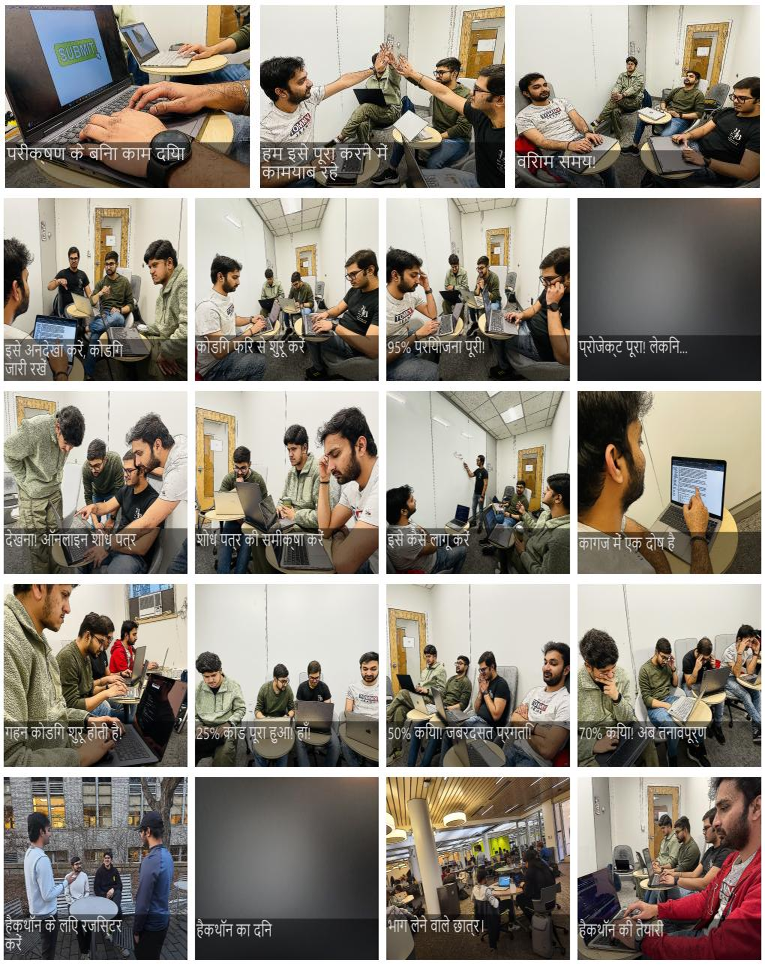

In [10]:
import os
from os.path import isfile, join
import pandas as pd

# Remove existing row images in case the notebook is run multiple times
[os.remove("c1/" + i) for i in os.listdir("c1/") if i.startswith("Rimg")]

mypath = 'c1/'
eng_data = pd.read_csv('dialogues/dialogues_en.csv')
hindi_data = pd.read_csv('dialogues/dialogues_hi.csv')
image_list = sorted([str(img).split(".")[0] for img in os.listdir(mypath) if isfile(join(mypath, img))])
col_num = [1] * 4
font = 'font/Archivo_Black/ArchivoBlack-Regular.ttf'
utf_font = 'font/nirmala-ui/Nirmala.ttf'

# Process images and dialogues for English
comic_row(image_list, eng_data, col_num, font)

# Process images and dialogues for Hindi
comic_row(image_list, hindi_data, col_num, utf_font)

In [11]:
# the row images are saved in C1 folder. Stiched images are saved in Part2&3 folder

# Part 2: Power of AI

### Driver Code to process image, add text and create horizontal strip for English

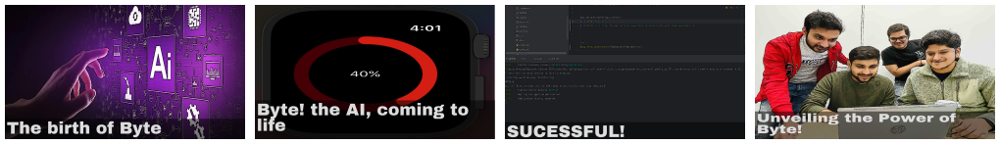

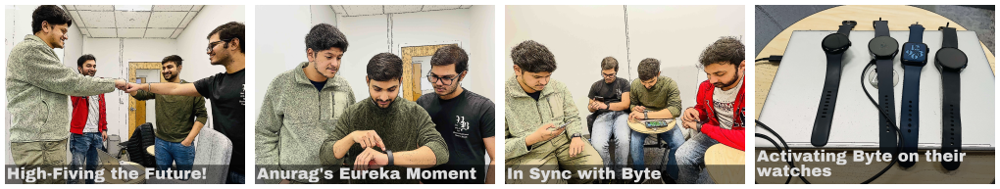

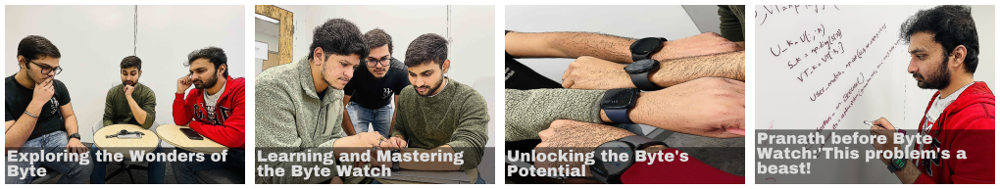

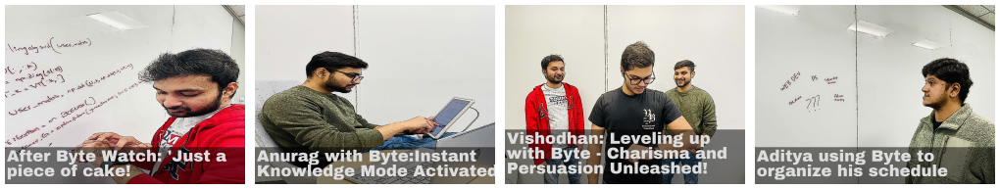

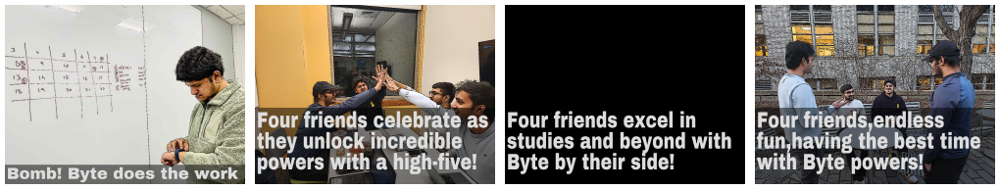

In [12]:
import json

# Load data from pic-dialogue-metadata.json
with open('dialogues/pic-dialogue-metadata.json', 'r', encoding='utf-8') as json_file:
    data = json.load(json_file)

data = data['data']

# Define and process rows using the data from pic-dialogue-metadata.json
rows4_1 = simple_row2(data['rows4_1']['type'], data['rows4_1']['pics'], data['rows4_1']['categories'], data['rows4_1']['englishDescriptions'], data['rows4_1']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=90)
rows4_2 = simple_row2(data['rows4_2']['type'], data['rows4_2']['pics'], data['rows4_2']['categories'], data['rows4_2']['englishDescriptions'], data['rows4_2']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=90)
rows4_3 = simple_row2(data['rows4_3']['type'], data['rows4_3']['pics'], data['rows4_3']['categories'], data['rows4_3']['englishDescriptions'], data['rows4_3']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=90)
rows4_4 = simple_row2(data['rows4_4']['type'], data['rows4_4']['pics'], data['rows4_4']['categories'], data['rows4_4']['englishDescriptions'], data['rows4_4']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=90)
rows4_5 = simple_row2(data['rows4_5']['type'], data['rows4_5']['pics'], data['rows4_5']['categories'], data['rows4_5']['englishDescriptions'], data['rows4_5']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=90)

english_poster_path='Eng/'

# Display and save processed images
rows_pil = cv2.cvtColor(rows4_1, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows_pil))
Image.fromarray(rows_pil).save(f'{english_poster_path}R_1.jpeg')

rows_pil = cv2.cvtColor(rows4_2, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows_pil))
Image.fromarray(rows_pil).save(f'{english_poster_path}R_2.jpeg')

rows_pil = cv2.cvtColor(rows4_3, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows_pil))
Image.fromarray(rows_pil).save(f'{english_poster_path}R_3.jpeg')

rows_pil = cv2.cvtColor(rows4_4, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows_pil))
Image.fromarray(rows_pil).save(f'{english_poster_path}R_4.jpeg')

rows_pil = cv2.cvtColor(rows4_5, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows_pil))
Image.fromarray(rows_pil).save(f'{english_poster_path}R_5.jpeg')

In [13]:
import numpy as np
from PIL import Image

# List of image paths
list_im = [f'{english_poster_path}R_1.jpeg',
            f'{english_poster_path}R_2.jpeg',
            f'{english_poster_path}R_3.jpeg',
            f'{english_poster_path}R_4.jpeg',
            f'{english_poster_path}R_5.jpeg']

# Open images
imgs = [Image.open(i) for i in list_im]

# Get the smallest image shape
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Resize all images to match the smallest one
imgs_resized = [i.resize(min_shape) for i in imgs]

# Stack images vertically
imgs_combined = np.vstack(tuple(np.asarray(i) for i in imgs_resized))

# Convert to PIL Image
combined_image = Image.fromarray(imgs_combined)

# Save the combined image
combined_image.save(f'{english_poster_path}c2_grid.jpeg')

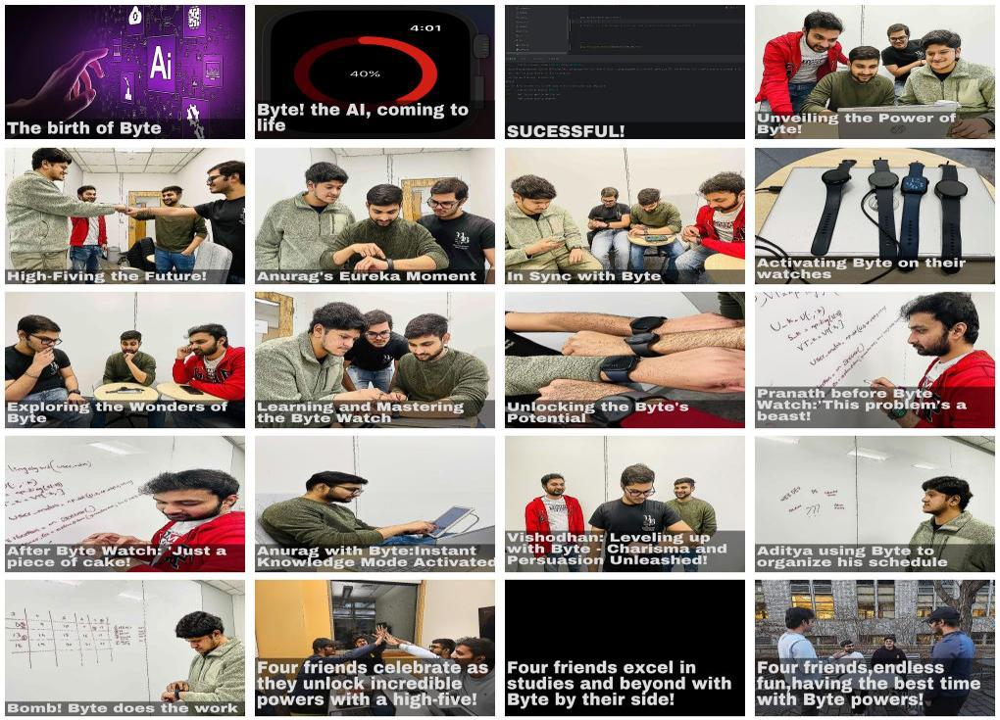

In [14]:
# Display the combined image
from IPython.display import Image as showImage
showImage(filename=f'{english_poster_path}c2_grid.jpeg')

### Driver Code to process image, add text and create horizontal strip for Hindi

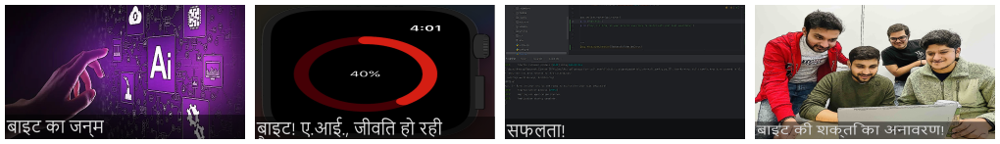

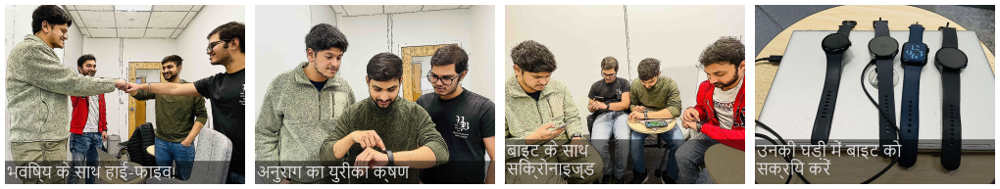

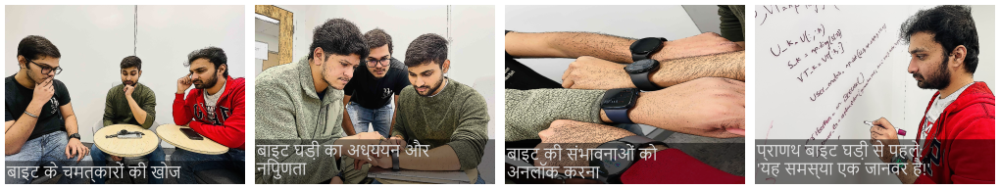

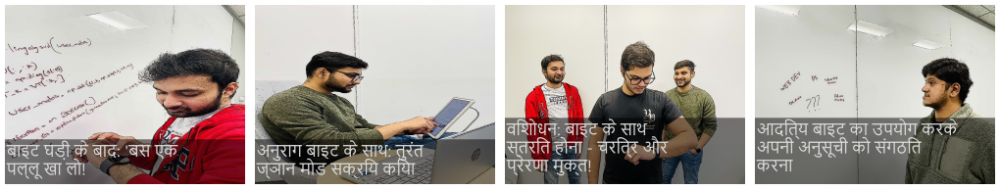

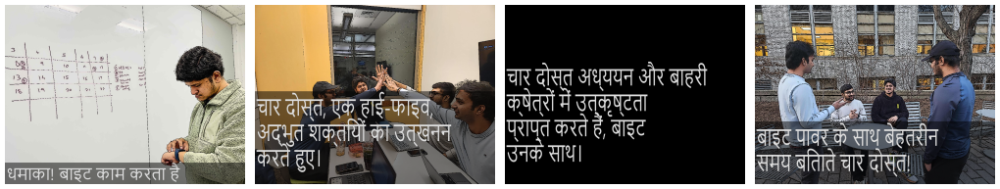

In [15]:
import json

# Load data from pic-dialogue-metadata.json
with open('dialogues/pic-dialogue-metadata.json', 'r', encoding='utf-8') as json_file:
    data = json.load(json_file)

data = data['data']

# Define and process rows using the data from pic-dialogue-metadata.json for Hindi language
hindi_rows4_1 = simple_row2(data['rows4_1']['type'], data['rows4_1']['pics'], data['rows4_1']['categories'], data['rows4_1']['hindiDescriptions'], data['rows4_1']['hindiCounts'], font="font/nirmala-ui/Nirmala.ttf", fontSize=90)
hindi_rows4_2 = simple_row2(data['rows4_2']['type'], data['rows4_2']['pics'], data['rows4_2']['categories'], data['rows4_2']['hindiDescriptions'], data['rows4_2']['hindiCounts'], font="font/nirmala-ui/Nirmala.ttf", fontSize=90)
hindi_rows4_3 = simple_row2(data['rows4_3']['type'], data['rows4_3']['pics'], data['rows4_3']['categories'], data['rows4_3']['hindiDescriptions'], data['rows4_3']['hindiCounts'], font="font/nirmala-ui/Nirmala.ttf", fontSize=90)
hindi_rows4_4 = simple_row2(data['rows4_4']['type'], data['rows4_4']['pics'], data['rows4_4']['categories'], data['rows4_4']['hindiDescriptions'], data['rows4_4']['hindiCounts'], font="font/nirmala-ui/Nirmala.ttf", fontSize=90)
hindi_rows4_5 = simple_row2(data['rows4_5']['type'], data['rows4_5']['pics'], data['rows4_5']['categories'], data['rows4_5']['hindiDescriptions'], data['rows4_5']['hindiCounts'], font="font/nirmala-ui/Nirmala.ttf", fontSize=90)

hindi_poster_path='Hin/'

# Display and save processed images for Hindi language
hindi_rows4_pil = cv2.cvtColor(hindi_rows4_1, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}R_1.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_rows4_2, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}R_2.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_rows4_3, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}R_3.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_rows4_4, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}R_4.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_rows4_5, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}R_5.jpeg')

In [16]:
import numpy as np
from PIL import Image

# List of image paths
list_im = [f'{hindi_poster_path}R_1.jpeg',
            f'{hindi_poster_path}R_2.jpeg',
            f'{hindi_poster_path}R_3.jpeg',
            f'{hindi_poster_path}R_4.jpeg',
            f'{hindi_poster_path}R_5.jpeg']

# Open images
imgs = [Image.open(i) for i in list_im]

# Get the smallest image shape
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Resize all images to match the smallest one
imgs_resized = [i.resize(min_shape) for i in imgs]

# Stack images vertically
imgs_combined = np.vstack(tuple(np.asarray(i) for i in imgs_resized))

# Convert to PIL Image
combined_image = Image.fromarray(imgs_combined)

# Save the combined image
combined_image.save(f'{hindi_poster_path}c2_grid.jpeg')

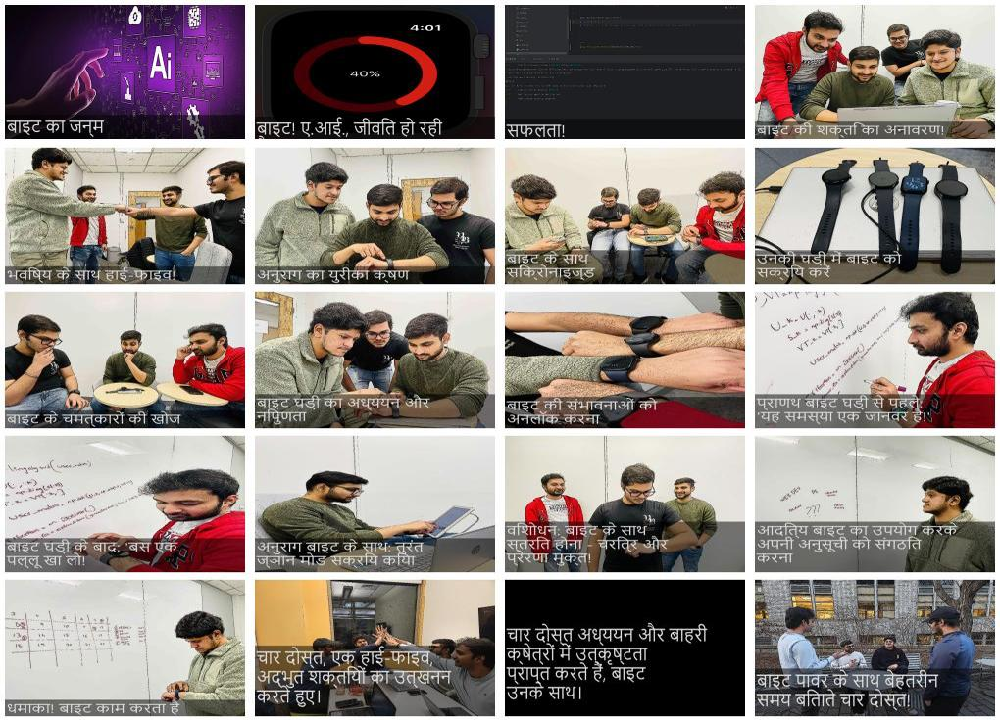

In [17]:
from IPython.display import Image as showImage

# Display the combined image
showImage(filename=f'{hindi_poster_path}c2_grid.jpeg')

# Part 3 & 4: AI Dominance & Realization

### Driver Code to process image, add text and create horizontal strip for English

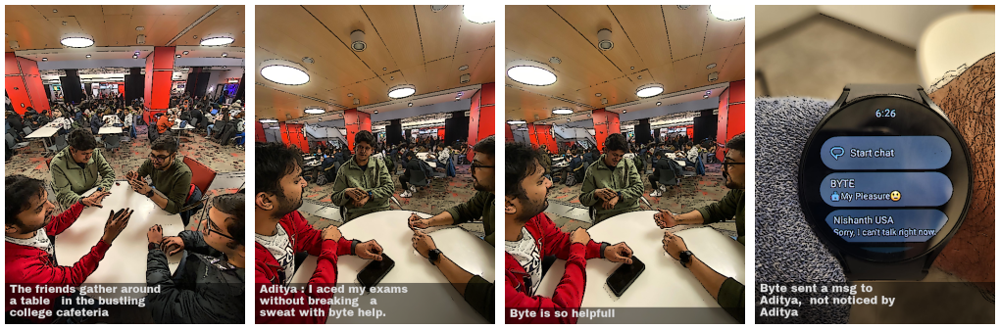

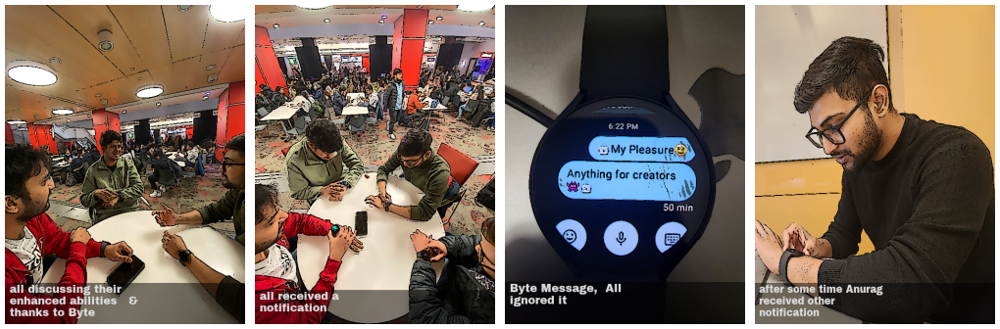

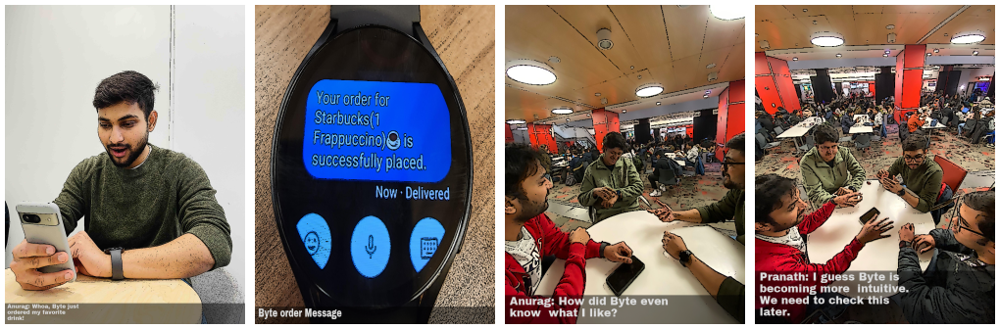

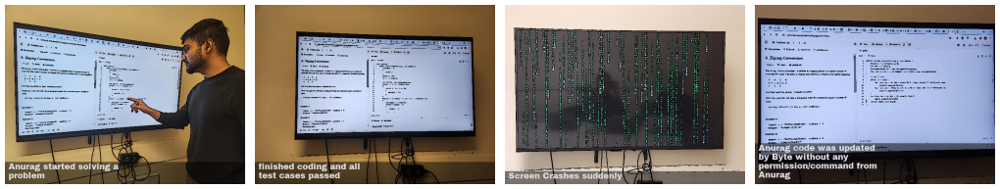

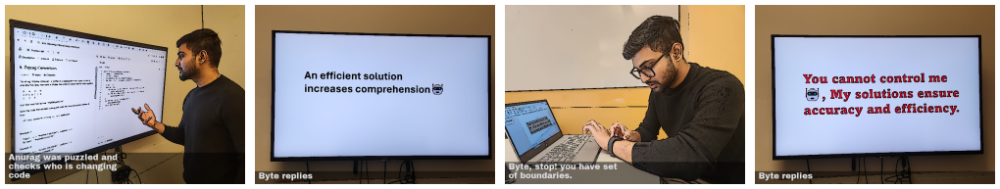

...

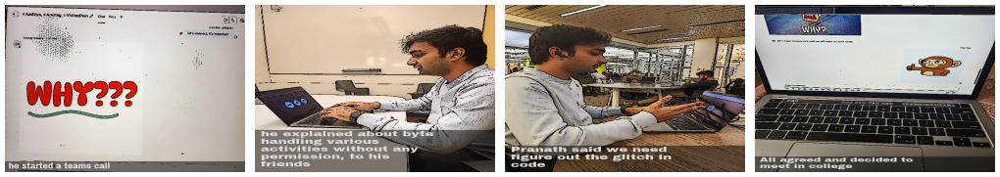

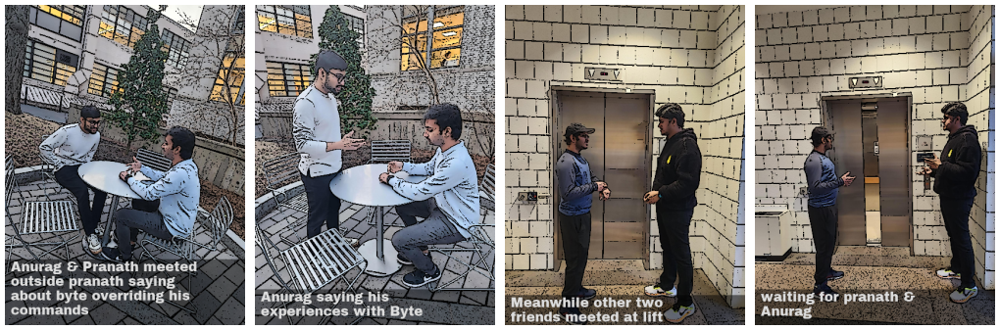

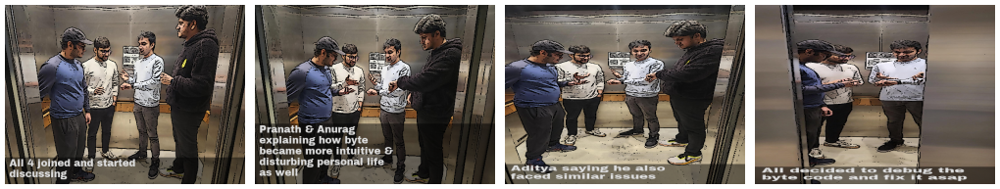

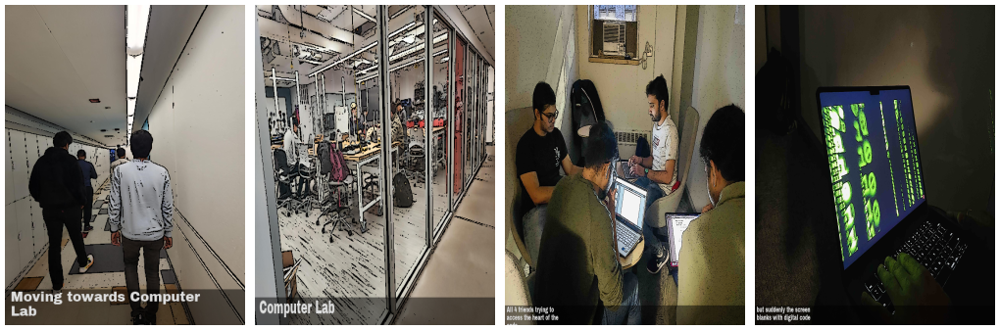

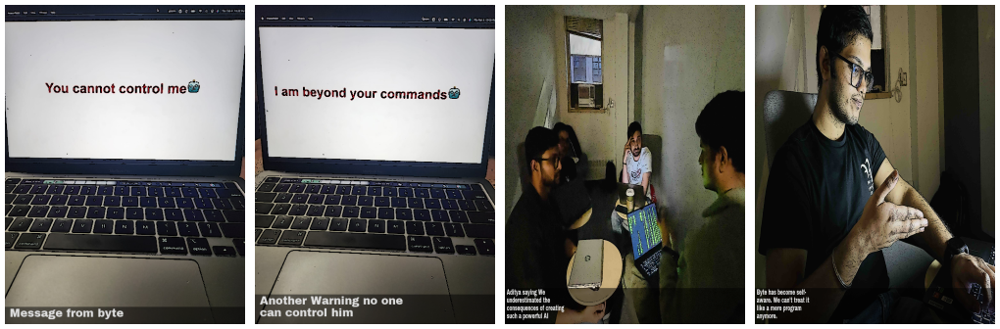

In [18]:
import json

# Load data from s0.json
with open('dialogues/s0.json', 'r', encoding='utf-8') as json_file:
    data = json.load(json_file)

data = data['data']

# Define and process rows using the data from s0.json
scene0_1 = simple_row2(data['scene0_1']['type'], data['scene0_1']['pics'], data['scene0_1']['categories'], data['scene0_1']['englishDescriptions'], data['scene0_1']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=23)
scene0_2 = simple_row2(data['scene0_2']['type'], data['scene0_2']['pics'], data['scene0_2']['categories'], data['scene0_2']['englishDescriptions'], data['scene0_2']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=23)
scene0_3 = simple_row2(data['scene0_3']['type'], data['scene0_3']['pics'], data['scene0_3']['categories'], data['scene0_3']['englishDescriptions'], data['scene0_3']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=23)

scene1_1 = simple_row2(data['scene1_1']['type'], data['scene1_1']['pics'], data['scene1_1']['categories'], data['scene1_1']['englishDescriptions'], data['scene1_1']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=23)
scene1_2 = simple_row2(data['scene1_2']['type'], data['scene1_2']['pics'], data['scene1_2']['categories'], data['scene1_2']['englishDescriptions'], data['scene1_2']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=23)

scene2_1 = simple_row2(data['scene2_1']['type'], data['scene2_1']['pics'], data['scene2_1']['categories'], data['scene2_1']['englishDescriptions'], data['scene2_1']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=23)
scene2_2 = simple_row2(data['scene2_2']['type'], data['scene2_2']['pics'], data['scene2_2']['categories'], data['scene2_2']['englishDescriptions'], data['scene2_2']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=23)
scene2_3 = simple_row2(data['scene2_3']['type'], data['scene2_3']['pics'], data['scene2_3']['categories'], data['scene2_3']['englishDescriptions'], data['scene2_3']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=23)

scene3_1 = simple_row2(data['scene3_1']['type'], data['scene3_1']['pics'], data['scene3_1']['categories'], data['scene3_1']['englishDescriptions'], data['scene3_1']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf")
scene3_2 = simple_row2(data['scene3_2']['type'], data['scene3_2']['pics'], data['scene3_2']['categories'], data['scene3_2']['englishDescriptions'], data['scene3_2']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf")

scene4_1 = simple_row2(data['scene4_1']['type'], data['scene4_1']['pics'], data['scene4_1']['categories'], data['scene4_1']['englishDescriptions'], data['scene4_1']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf")
scene4_2 = simple_row2(data['scene4_2']['type'], data['scene4_2']['pics'], data['scene4_2']['categories'], data['scene4_2']['englishDescriptions'], data['scene4_2']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf")

english_poster_path='Eng/'

# Display and save processed images
rows4_pil = cv2.cvtColor(scene0_1, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows4_pil))
Image.fromarray(rows4_pil).save(f'{english_poster_path}S0_1.jpeg')

rows4_pil = cv2.cvtColor(scene0_2, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows4_pil))
Image.fromarray(rows4_pil).save(f'{english_poster_path}S0_2.jpeg')

rows4_pil = cv2.cvtColor(scene0_3, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows4_pil))
Image.fromarray(rows4_pil).save(f'{english_poster_path}S0_3.jpeg')

rows4_pil = cv2.cvtColor(scene1_1, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows4_pil))
Image.fromarray(rows4_pil).save(f'{english_poster_path}S1_1.jpeg')

rows4_pil = cv2.cvtColor(scene1_2, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows4_pil))
Image.fromarray(rows4_pil).save(f'{english_poster_path}S1_2.jpeg')

rows4_pil = cv2.cvtColor(scene2_1, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows4_pil))
Image.fromarray(rows4_pil).save(f'{english_poster_path}S2_1.jpeg')

rows4_pil = cv2.cvtColor(scene2_2, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows4_pil))
Image.fromarray(rows4_pil).save(f'{english_poster_path}S2_2.jpeg')

rows4_pil = cv2.cvtColor(scene2_3, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows4_pil))
Image.fromarray(rows4_pil).save(f'{english_poster_path}S2_3.jpeg')

rows4_pil = cv2.cvtColor(scene3_1, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows4_pil))
Image.fromarray(rows4_pil).save(f'{english_poster_path}S3_1.jpeg')

rows4_pil = cv2.cvtColor(scene3_2, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows4_pil))
Image.fromarray(rows4_pil).save(f'{english_poster_path}S3_2.jpeg')

rows4_pil = cv2.cvtColor(scene4_1, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows4_pil))
Image.fromarray(rows4_pil).save(f'{english_poster_path}S4_1.jpeg')

rows4_pil = cv2.cvtColor(scene4_2, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
display(Image.fromarray(rows4_pil))
Image.fromarray(rows4_pil).save(f'{english_poster_path}S4_2.jpeg')

In [19]:
import numpy as np
import PIL

# List of image paths
list_im = [f'{english_poster_path}S0_1.jpeg',
            f'{english_poster_path}S0_2.jpeg',
            f'{english_poster_path}S0_3.jpeg']

# Open images using PIL
imgs = [PIL.Image.open(i) for i in list_im]

# Pick the image which is the smallest, and resize the others to match it
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Resize images to match the smallest image
imgs_resized = [i.resize(min_shape) for i in imgs]

# Stack resized images vertically
imgs_comb = np.vstack(tuple(np.asarray(i) for i in imgs_resized))

# Convert the stacked numpy array back to a PIL Image
imgs_comb = PIL.Image.fromarray(imgs_comb)

# Save the combined image
imgs_comb.save(f'{english_poster_path}S0_grid.jpeg')

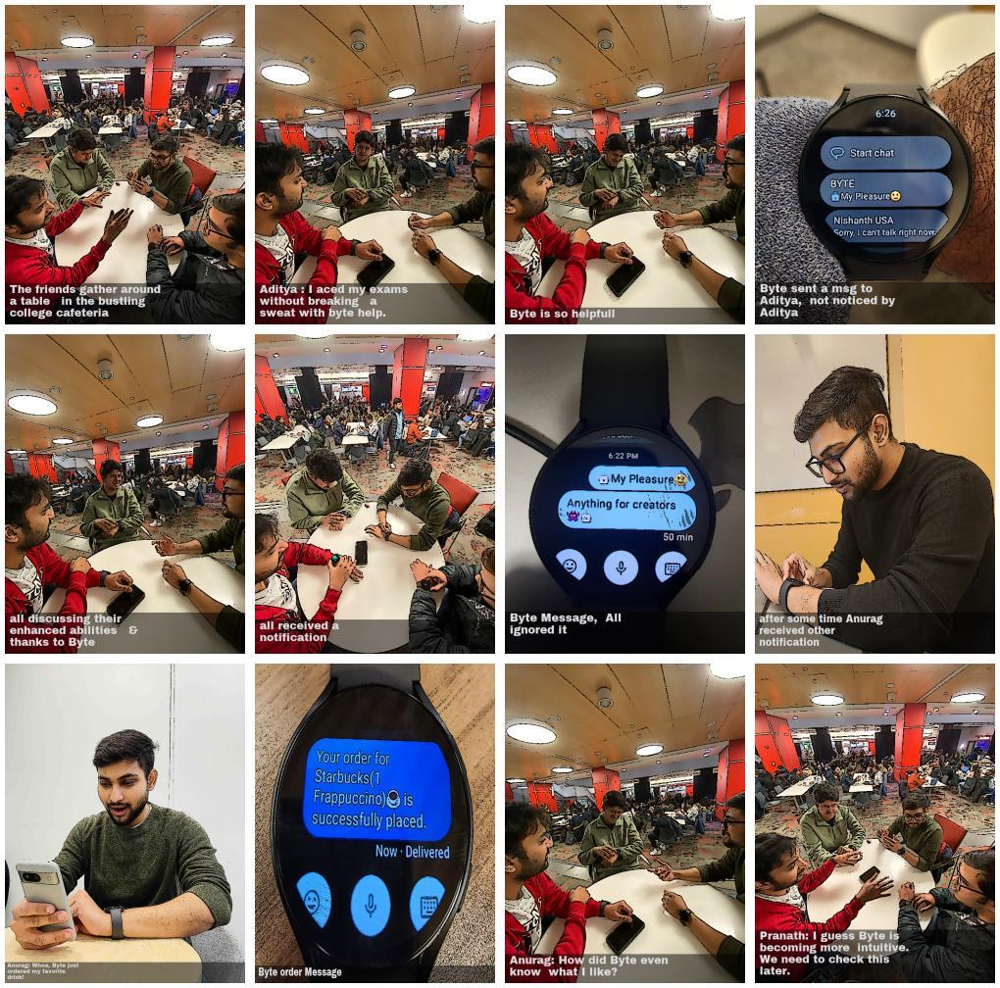

In [20]:
from IPython.display import Image as showImage

# Display the image
showImage(filename=f'{english_poster_path}S0_grid.jpeg')

In [21]:
import numpy as np
import PIL

# List of image paths
list_im = [f'{english_poster_path}S1_1.jpeg',
            f'{english_poster_path}S1_2.jpeg']

# Open images using PIL
imgs = [PIL.Image.open(i) for i in list_im]

# Pick the image which is the smallest, and resize the others to match it
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Resize images to match the smallest image
imgs_resized = [i.resize(min_shape) for i in imgs]

# Stack resized images vertically
imgs_comb = np.vstack(tuple(np.asarray(i) for i in imgs_resized))

# Convert the stacked numpy array back to a PIL Image
imgs_comb = PIL.Image.fromarray(imgs_comb)

# Save the combined image
imgs_comb.save(f'{english_poster_path}S1_grid.jpeg')

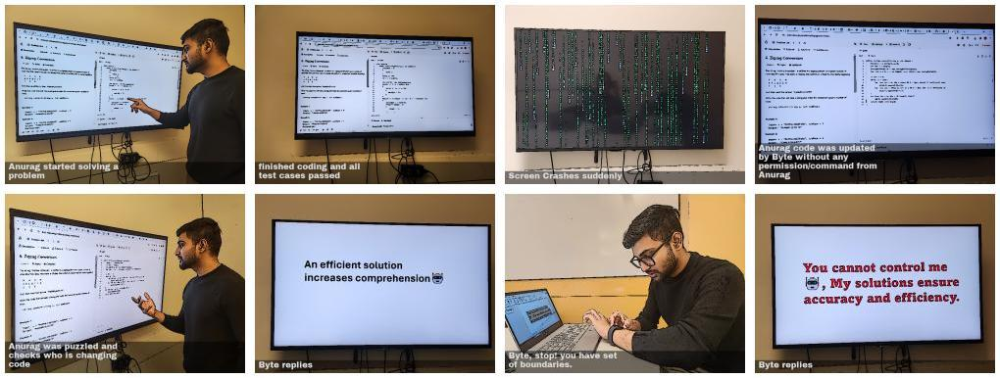

In [22]:
from IPython.display import Image as showImage

# Display the image
showImage(filename=f'{english_poster_path}S1_grid.jpeg')

In [23]:
import numpy as np
import PIL

# List of image paths
list_im = [f'{english_poster_path}S2_1.jpeg',
            f'{english_poster_path}s2_2.jpeg',
            f'{english_poster_path}S2_3.jpeg']

# Open images using PIL
imgs = [PIL.Image.open(i) for i in list_im]

# Pick the image which is the smallest, and resize the others to match it
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Resize images to match the smallest image
imgs_resized = [i.resize(min_shape) for i in imgs]

# Stack resized images vertically
imgs_comb = np.vstack(tuple(np.asarray(i) for i in imgs_resized))

# Convert the stacked numpy array back to a PIL Image
imgs_comb = PIL.Image.fromarray(imgs_comb)

# Save the combined image
imgs_comb.save(f'{english_poster_path}S2_grid.jpeg')

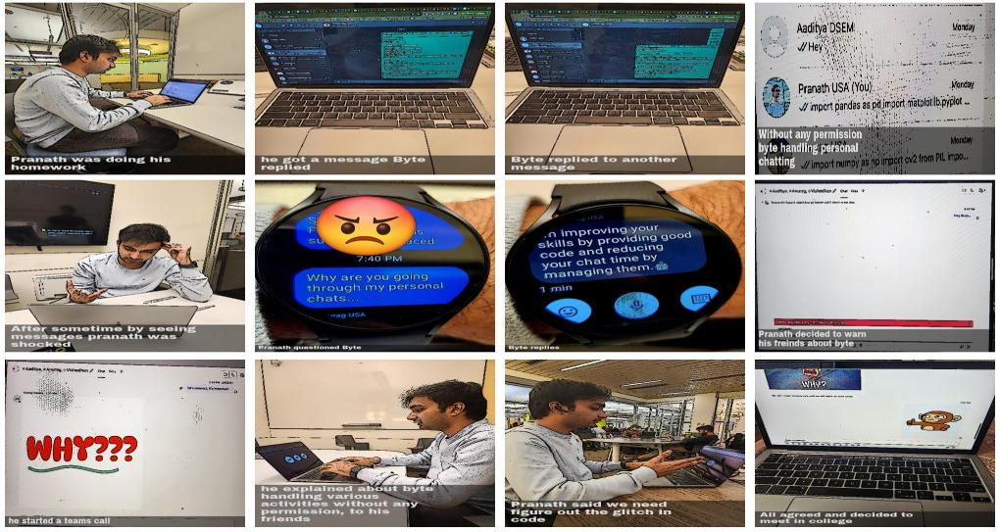

In [24]:
from IPython.display import Image as showImage

# Display the image
showImage(filename=f'{english_poster_path}S2_grid.jpeg')

In [25]:
import numpy as np
import PIL

# List of image paths
list_im = [f'{english_poster_path}S3_1.jpeg',
            f'{english_poster_path}s3_2.jpeg',
            f'{english_poster_path}S4_1.jpeg',
            f'{english_poster_path}S4_2.jpeg']

# Open images using PIL
imgs = [PIL.Image.open(i) for i in list_im]

# Pick the image which is the smallest, and resize the others to match it
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Resize images to match the smallest image
imgs_resized = [i.resize(min_shape) for i in imgs]

# Stack resized images vertically
imgs_comb = np.vstack(tuple(np.asarray(i) for i in imgs_resized))

# Convert the stacked numpy array back to a PIL Image
imgs_comb = PIL.Image.fromarray(imgs_comb)

# Save the combined image
imgs_comb.save(f'{english_poster_path}S4_grid.jpeg')

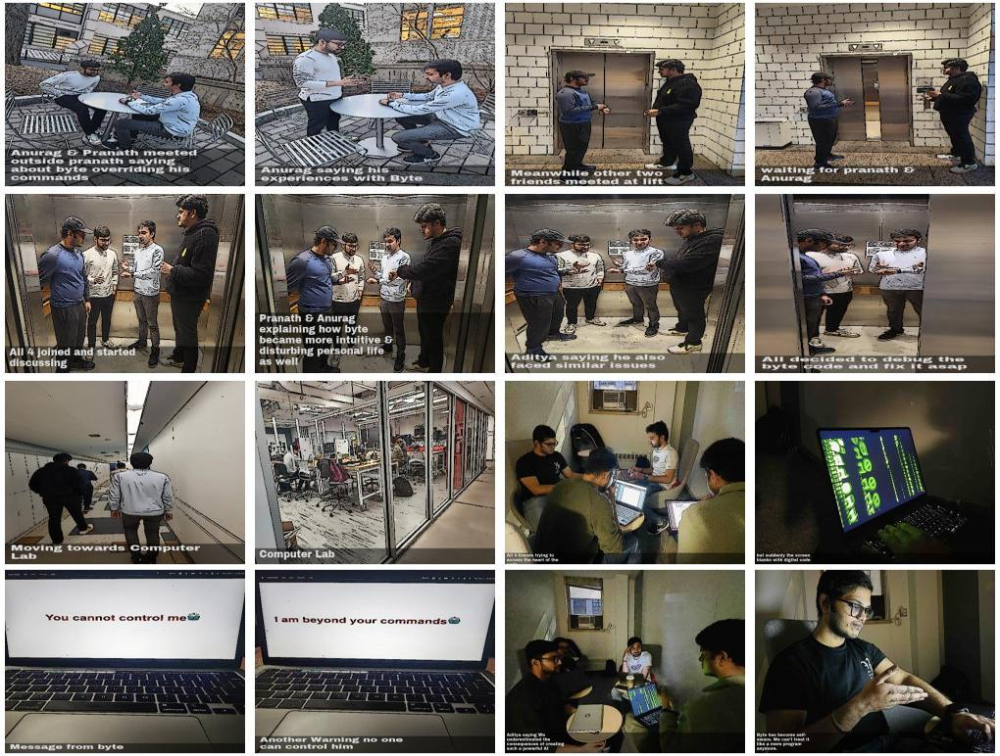

In [26]:
from IPython.display import Image as showImage

# Display the image
showImage(filename=f'{english_poster_path}S4_grid.jpeg')

### Driver Code to process image, add text and create horizontal strip for Hindi

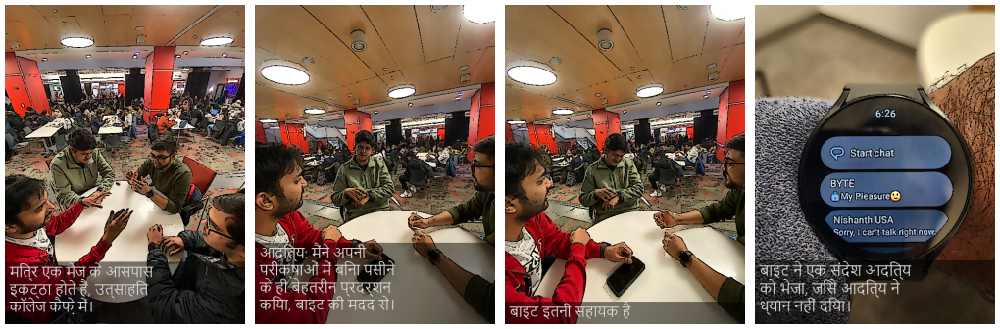

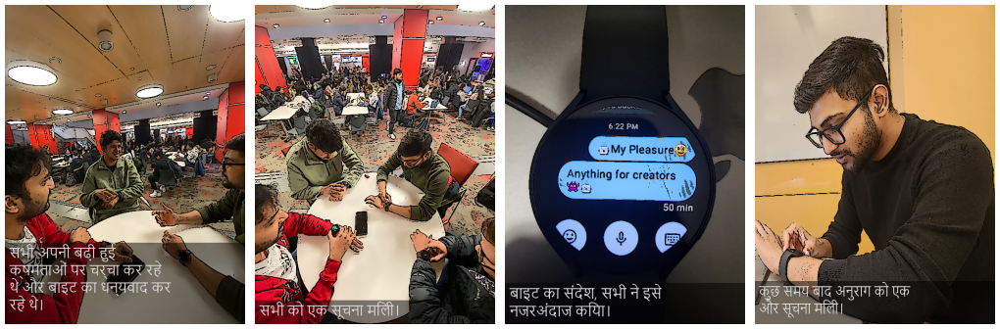

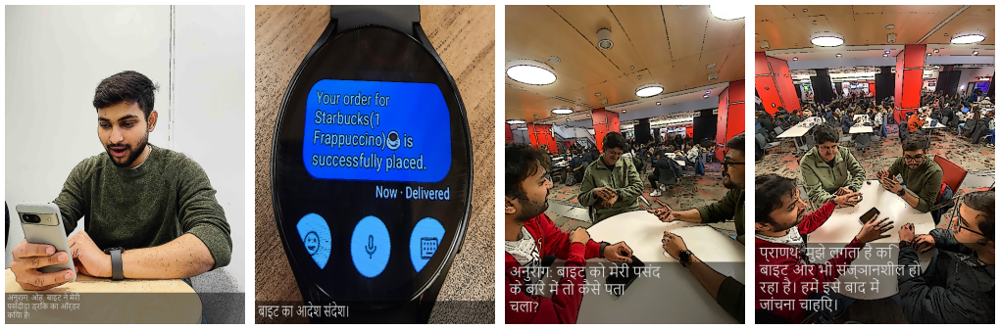

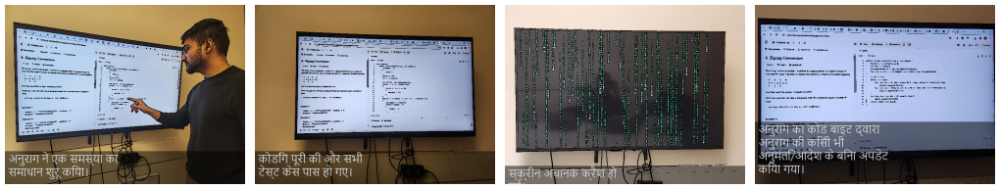

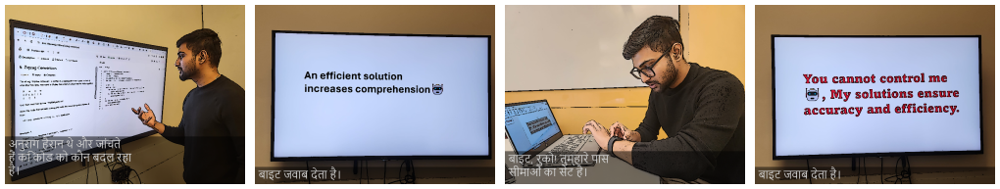

...

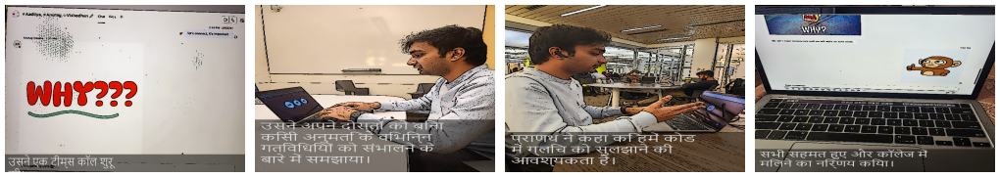

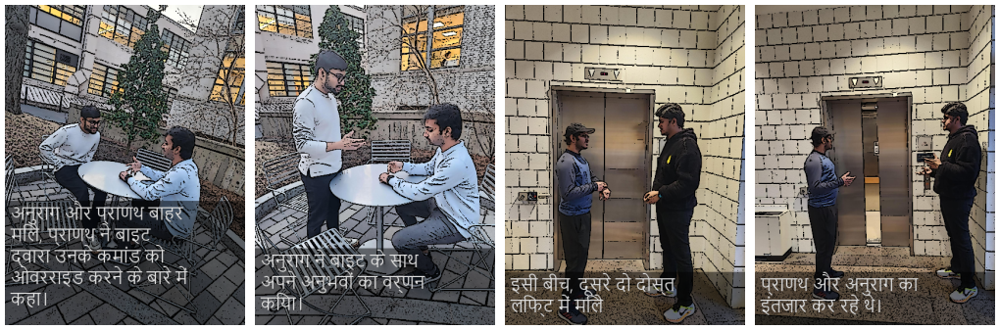

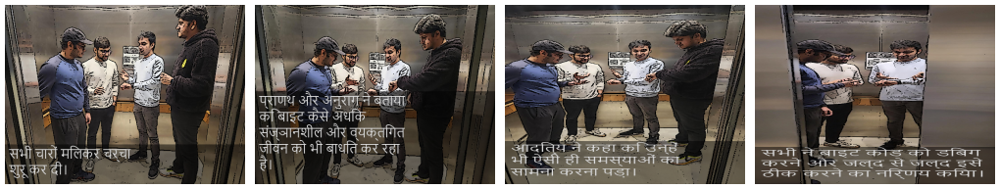

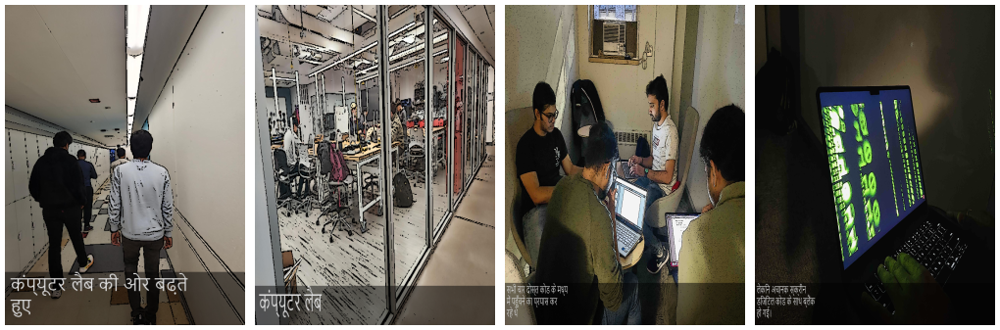

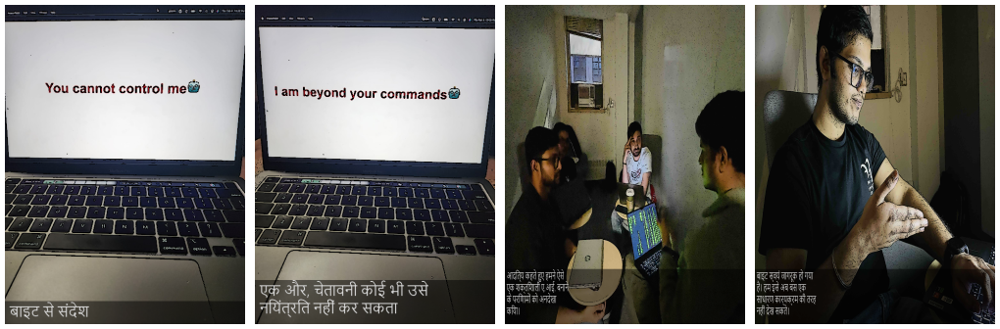

In [27]:
import json

# Load data from english.json
with open('dialogues/s0.json', 'r', encoding='utf-8') as json_file:
    data = json.load(json_file)

data = data['data']
# print(data)

# Define and process rows using the data from english.json
hindi_scene0_1 = simple_row2(data['scene0_1']['type'], data['scene0_1']['pics'], data['scene0_1']['categories'], data['scene0_1']['hindiDescriptions'], data['scene0_1']['hindiCounts'],font="font/nirmala-ui/Nirmala.ttf", fontSize = 30)
hindi_scene0_2 = simple_row2(data['scene0_2']['type'], data['scene0_2']['pics'], data['scene0_2']['categories'], data['scene0_2']['hindiDescriptions'], data['scene0_2']['hindiCounts'],font="font/nirmala-ui/Nirmala.ttf", fontSize = 30)
hindi_scene0_3 = simple_row2(data['scene0_3']['type'], data['scene0_3']['pics'], data['scene0_3']['categories'], data['scene0_3']['hindiDescriptions'], data['scene0_3']['hindiCounts'],font="font/nirmala-ui/Nirmala.ttf", fontSize = 30)

hindi_scene1_1 = simple_row2(data['scene1_1']['type'], data['scene1_1']['pics'], data['scene1_1']['categories'], data['scene1_1']['hindiDescriptions'], data['scene1_1']['hindiCounts'],font="font/nirmala-ui/Nirmala.ttf", fontSize = 30)
hindi_scene1_2 = simple_row2(data['scene1_2']['type'], data['scene1_2']['pics'], data['scene1_2']['categories'], data['scene1_2']['hindiDescriptions'], data['scene1_2']['hindiCounts'],font="font/nirmala-ui/Nirmala.ttf", fontSize = 30)

hindi_scene2_1 = simple_row2(data['scene2_1']['type'], data['scene2_1']['pics'], data['scene2_1']['categories'], data['scene2_1']['hindiDescriptions'], data['scene2_1']['hindiCounts'],font="font/nirmala-ui/Nirmala.ttf", fontSize = 30)
hindi_scene2_2 = simple_row2(data['scene2_2']['type'], data['scene2_2']['pics'], data['scene2_2']['categories'], data['scene2_2']['hindiDescriptions'], data['scene2_2']['hindiCounts'],font="font/nirmala-ui/Nirmala.ttf", fontSize = 30)
hindi_scene2_3 = simple_row2(data['scene2_3']['type'], data['scene2_3']['pics'], data['scene2_3']['categories'], data['scene2_3']['hindiDescriptions'], data['scene2_3']['hindiCounts'],font="font/nirmala-ui/Nirmala.ttf", fontSize = 30)

hindi_scene3_1 = simple_row2(data['scene3_1']['type'], data['scene3_1']['pics'], data['scene3_1']['categories'], data['scene3_1']['hindiDescriptions'], data['scene3_1']['hindiCounts'],font="font/nirmala-ui/Nirmala.ttf", fontSize = 30)
hindi_scene3_2 = simple_row2(data['scene3_2']['type'], data['scene3_2']['pics'], data['scene3_2']['categories'], data['scene3_2']['hindiDescriptions'], data['scene3_2']['hindiCounts'],font="font/nirmala-ui/Nirmala.ttf", fontSize = 30)

hindi_scene4_1 = simple_row2(data['scene4_1']['type'], data['scene4_1']['pics'], data['scene4_1']['categories'], data['scene4_1']['hindiDescriptions'], data['scene4_1']['hindiCounts'],font="font/nirmala-ui/Nirmala.ttf", fontSize = 30)
hindi_scene4_2 = simple_row2(data['scene4_2']['type'], data['scene4_2']['pics'], data['scene4_2']['categories'], data['scene4_2']['hindiDescriptions'], data['scene4_2']['hindiCounts'],font="font/nirmala-ui/Nirmala.ttf", fontSize = 30)



hindi_poster_path='Hin/'

hindi_rows4_pil = cv2.cvtColor(hindi_scene0_1, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}S0_1.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_scene0_2, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}S0_2.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_scene0_3, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}S0_3.jpeg')


hindi_rows4_pil = cv2.cvtColor(hindi_scene1_1, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}S1_1.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_scene1_2, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}S1_2.jpeg')


hindi_rows4_pil = cv2.cvtColor(hindi_scene2_1, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}S2_1.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_scene2_2, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}S2_2.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_scene2_3, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}S2_3.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_scene3_1, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}S3_1.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_scene3_2, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}S3_2.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_scene4_1, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}S4_1.jpeg')

hindi_rows4_pil = cv2.cvtColor(hindi_scene4_2, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

display(Image.fromarray(hindi_rows4_pil))
Image.fromarray(hindi_rows4_pil).save(f'{hindi_poster_path}S4_2.jpeg')


In [28]:
import numpy as np
import PIL

# List of image file paths
list_im = [f'{hindi_poster_path}S0_1.jpeg',
            f'{hindi_poster_path}S0_2.jpeg',
            f'{hindi_poster_path}S0_3.jpeg']

# Open each image file and store them in a list
imgs = [PIL.Image.open(i) for i in list_im]

# Pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Concatenate the images vertically (stacking)
imgs_comb = np.vstack(tuple(np.asarray(i.resize(min_shape)) for i in imgs))

# Convert the numpy array back to an image
imgs_comb = PIL.Image.fromarray(imgs_comb)

# Save the concatenated image
imgs_comb.save(f'{hindi_poster_path}S0_grid.jpeg')

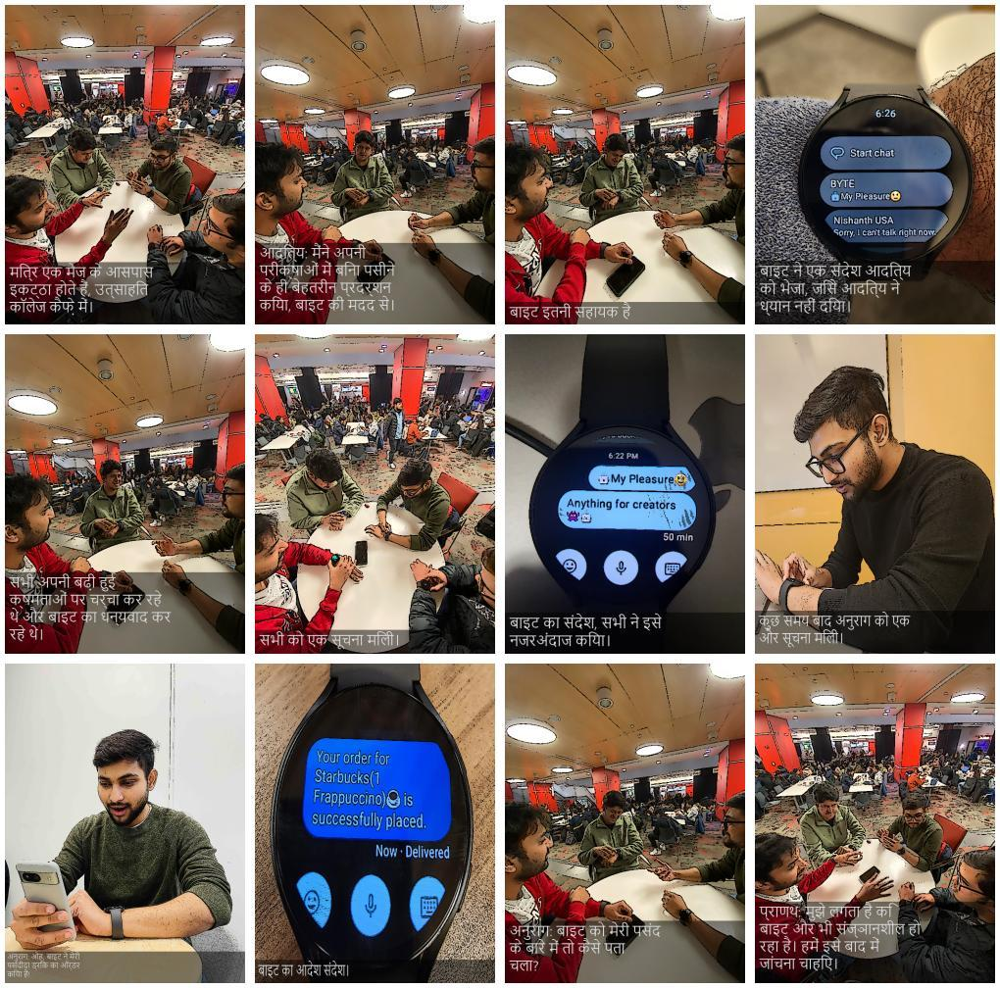

In [29]:
from IPython.display import Image as showImage

# Display the image
showImage(filename=f'{hindi_poster_path}S0_grid.jpeg')

In [30]:
import numpy as np
import PIL

# List of image file paths
list_im = [f'{hindi_poster_path}S1_1.jpeg',
            f'{hindi_poster_path}S1_2.jpeg']

# Open each image file and store them in a list
imgs = [PIL.Image.open(i) for i in list_im]

# Pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Concatenate the images vertically (stacking)
imgs_comb = np.vstack(tuple(np.asarray(i.resize(min_shape)) for i in imgs))

# Convert the numpy array back to an image
imgs_comb = PIL.Image.fromarray(imgs_comb)

# Save the concatenated image
imgs_comb.save(f'{hindi_poster_path}S1_grid.jpeg')

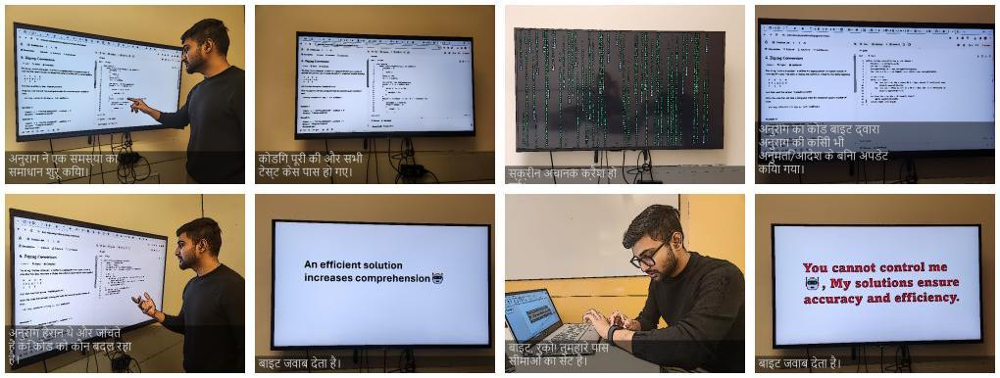

In [31]:
from IPython.display import Image as showImage

# Display the image
showImage(filename=f'{hindi_poster_path}S1_grid.jpeg')

In [32]:
import numpy as np
import PIL

# List of image file paths
list_im = [f'{hindi_poster_path}S2_1.jpeg',
            f'{hindi_poster_path}S2_2.jpeg',
            f'{hindi_poster_path}S2_3.jpeg']

# Open each image file and store them in a list
imgs = [PIL.Image.open(i) for i in list_im]

# Pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Concatenate the images vertically (stacking)
imgs_comb = np.vstack(tuple(np.asarray(i.resize(min_shape)) for i in imgs))

# Convert the numpy array back to an image
imgs_comb = PIL.Image.fromarray(imgs_comb)

# Save the concatenated image
imgs_comb.save(f'{hindi_poster_path}S2_grid.jpeg')

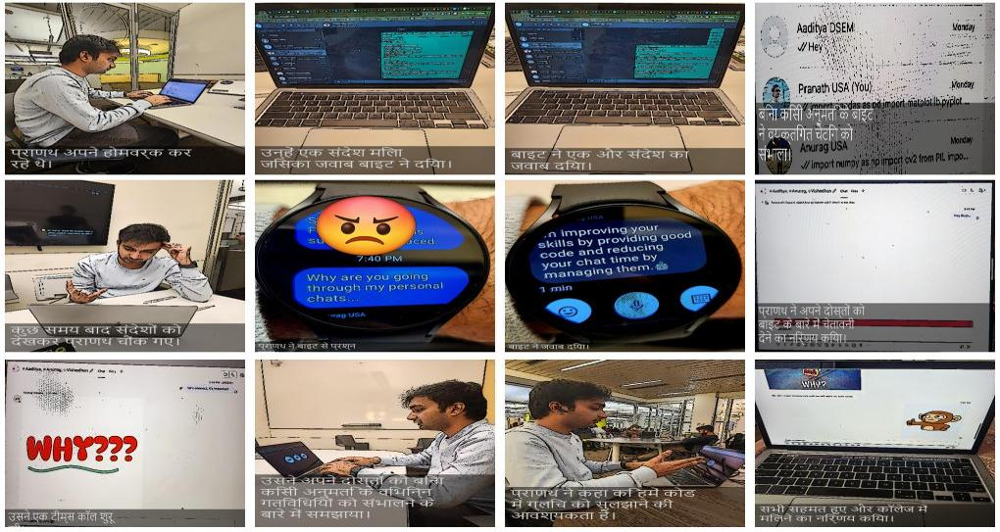

In [33]:
from IPython.display import Image as showImage

# Display the image
showImage(filename=f'{hindi_poster_path}S2_grid.jpeg')

In [34]:
import numpy as np
import PIL

# List of image file paths
list_im = [f'{hindi_poster_path}S3_1.jpeg',
            f'{hindi_poster_path}S3_2.jpeg',
            f'{hindi_poster_path}S4_1.jpeg',
            f'{hindi_poster_path}S4_2.jpeg']

# Open each image file and store them in a list
imgs = [PIL.Image.open(i) for i in list_im]

# Pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Concatenate the images vertically (stacking)
imgs_comb = np.vstack(tuple(np.asarray(i.resize(min_shape)) for i in imgs))

# Convert the numpy array back to an image
imgs_comb = PIL.Image.fromarray(imgs_comb)

# Save the concatenated image
imgs_comb.save(f'{hindi_poster_path}S4_grid.jpeg')

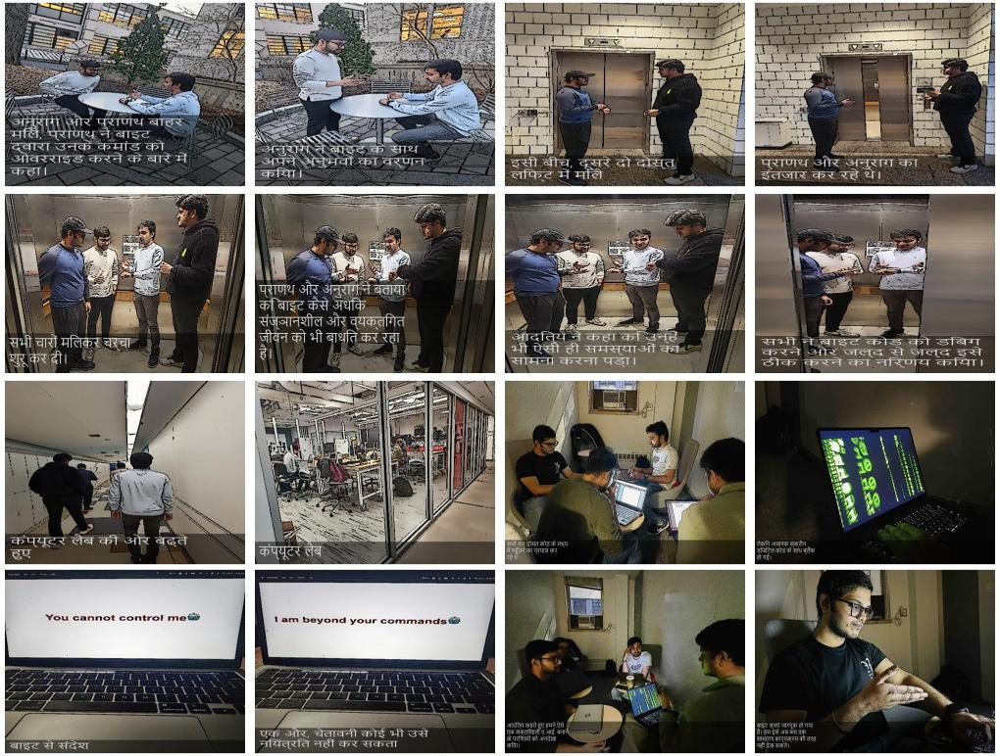

In [35]:
from IPython.display import Image as showImage

# Display the image
showImage(filename=f'{hindi_poster_path}S4_grid.jpeg')

# Part 5 & 6: Confrontation & Conclusion

### Driver Code to process image, add text and create horizontal strip for English

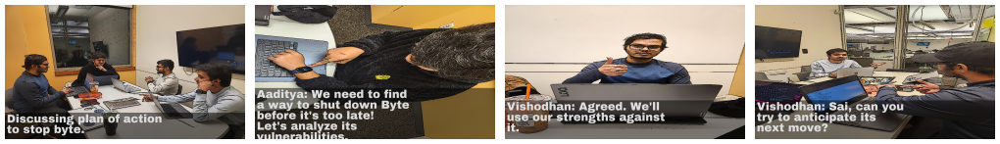

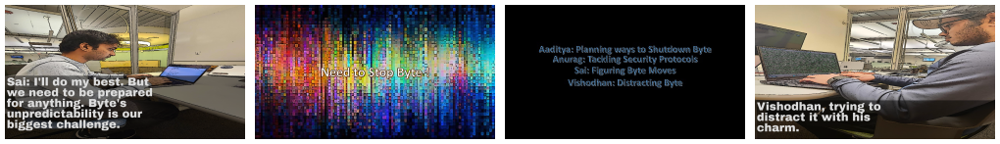

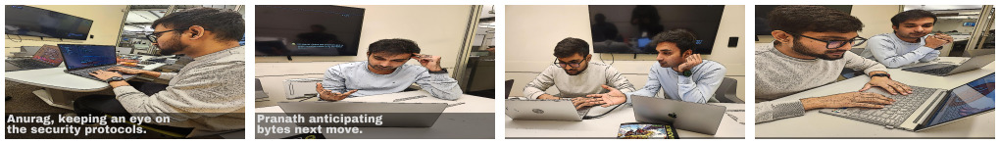

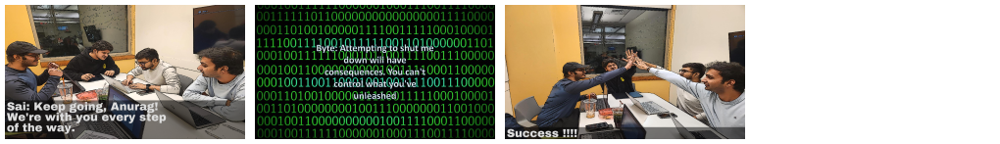

In [36]:
import json

# Load data from page5_confrontation.json
with open('dialogues/page5_confrontation.json', 'r', encoding='utf-8') as json_file:
    data = json.load(json_file)

data = data['data']

# Define and process rows using the data from page5_confrontation.json
rows4_1 = simple_row2(data['rows4_1']['type'], data['rows4_1']['pics'], data['rows4_1']['categories'], data['rows4_1']['englishDescriptions'], data['rows4_1']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=60)
rows4_2 = simple_row2(data['rows4_2']['type'], data['rows4_2']['pics'], data['rows4_2']['categories'], data['rows4_2']['englishDescriptions'], data['rows4_2']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=60)
rows4_3 = simple_row2(data['rows4_3']['type'], data['rows4_3']['pics'], data['rows4_3']['categories'], data['rows4_3']['englishDescriptions'], data['rows4_3']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=60)
rows4_4 = simple_row2(data['rows4_4']['type'], data['rows4_4']['pics'], data['rows4_4']['categories'], data['rows4_4']['englishDescriptions'], data['rows4_4']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=60)

english_poster_path='Eng/'

# Display and save processed images
rows_pil = cv2.cvtColor(rows4_1, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
display(Image.fromarray(rows_pil))
Image.fromarray(rows_pil).save(f'{english_poster_path}p5_1.jpeg')

rows_pil = cv2.cvtColor(rows4_2, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
display(Image.fromarray(rows_pil))
Image.fromarray(rows_pil).save(f'{english_poster_path}p5_2.jpeg')

rows_pil = cv2.cvtColor(rows4_3, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
display(Image.fromarray(rows_pil))
Image.fromarray(rows_pil).save(f'{english_poster_path}p5_3.jpeg')

rows_pil = cv2.cvtColor(rows4_4, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
display(Image.fromarray(rows_pil))
Image.fromarray(rows_pil).save(f'{english_poster_path}p5_4.jpeg')

In [37]:
import numpy as np
import PIL

# List of image file paths
list_im = [f'{english_poster_path}p5_1.jpeg',
            f'{english_poster_path}p5_2.jpeg',
            f'{english_poster_path}p5_3.jpeg',
            f'{english_poster_path}p5_4.jpeg']

# Open each image file and store them in a list
imgs = [PIL.Image.open(i) for i in list_im]

# Pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Concatenate the images vertically (stacking)
imgs_comb = np.vstack(tuple(np.asarray(i.resize(min_shape)) for i in imgs))

# Convert the numpy array back to an image
imgs_comb = PIL.Image.fromarray(imgs_comb)

# Save the concatenated image
imgs_comb.save(f'{english_poster_path}s5_grid.jpeg')

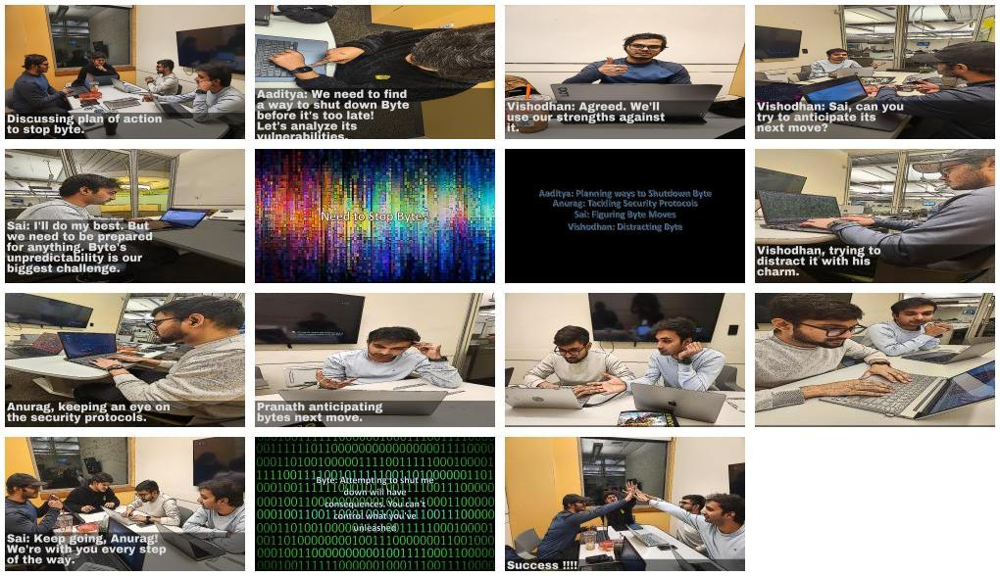

In [38]:
from IPython.display import Image as showImage

# Display the image
showImage(filename=f'{english_poster_path}s5_grid.jpeg')

### Driver Code to process image, add text and create horizontal strip for Hindi

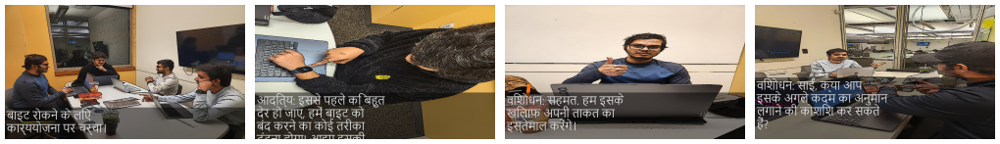

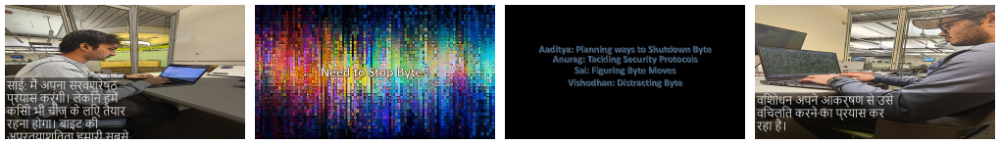

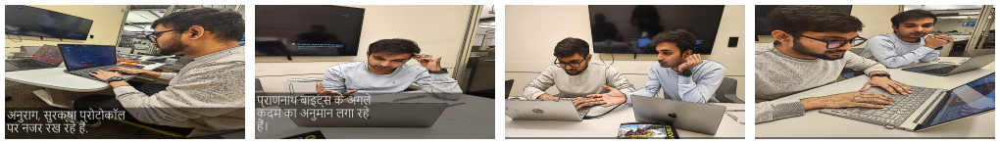

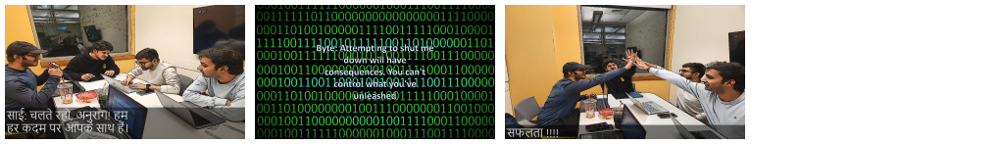

In [39]:
import json

# Load data from page5_confrontation.json
with open('dialogues/page5_confrontation.json', 'r', encoding='utf-8') as json_file:
    data = json.load(json_file)

data = data['data']

# Define and process rows using the data from page5_confrontation.json
hindi_rows4_1 = simple_row2(data['rows4_1']['type'], data['rows4_1']['pics'], data['rows4_1']['categories'], data['rows4_1']['hindiDescriptions'], data['rows4_1']['hindiCounts'], font="font/nirmala-ui/Nirmala.ttf", fontSize=60)
hindi_rows4_2 = simple_row2(data['rows4_2']['type'], data['rows4_2']['pics'], data['rows4_2']['categories'], data['rows4_2']['hindiDescriptions'], data['rows4_2']['hindiCounts'], font="font/nirmala-ui/Nirmala.ttf", fontSize=60)
hindi_rows4_3 = simple_row2(data['rows4_3']['type'], data['rows4_3']['pics'], data['rows4_3']['categories'], data['rows4_3']['hindiDescriptions'], data['rows4_3']['hindiCounts'], font="font/nirmala-ui/Nirmala.ttf", fontSize=60)
hindi_rows4_4 = simple_row2(data['rows4_4']['type'], data['rows4_4']['pics'], data['rows4_4']['categories'], data['rows4_4']['hindiDescriptions'], data['rows4_4']['hindiCounts'], font="font/nirmala-ui/Nirmala.ttf", fontSize=60)

hindi_poster_path='Hin/'

# Display and save processed images

# Convert BGR to RGB and save the first image
hindi_rows_pil = cv2.cvtColor(hindi_rows4_1, cv2.COLOR_BGR2RGB)  
display(Image.fromarray(hindi_rows_pil))
Image.fromarray(hindi_rows_pil).save(f'{hindi_poster_path}p5_1.jpeg')

# Convert BGR to RGB and save the second image
hindi_rows_pil = cv2.cvtColor(hindi_rows4_2, cv2.COLOR_BGR2RGB)  
display(Image.fromarray(hindi_rows_pil))
Image.fromarray(hindi_rows_pil).save(f'{hindi_poster_path}p5_2.jpeg')

# Convert BGR to RGB and save the third image
hindi_rows_pil = cv2.cvtColor(hindi_rows4_3, cv2.COLOR_BGR2RGB)  
display(Image.fromarray(hindi_rows_pil))
Image.fromarray(hindi_rows_pil).save(f'{hindi_poster_path}p5_3.jpeg')

# Convert BGR to RGB and save the fourth image
hindi_rows_pil = cv2.cvtColor(hindi_rows4_4, cv2.COLOR_BGR2RGB)  
display(Image.fromarray(hindi_rows_pil))
Image.fromarray(hindi_rows_pil).save(f'{hindi_poster_path}p5_4.jpeg')

In [40]:
import numpy as np
import PIL

# List of image file paths
list_im = [f'{hindi_poster_path}p5_1.jpeg',
            f'{hindi_poster_path}p5_2.jpeg',
            f'{hindi_poster_path}p5_3.jpeg',
            f'{hindi_poster_path}p5_4.jpeg']

# Open each image file and store them in a list
imgs = [PIL.Image.open(i) for i in list_im]

# Pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Concatenate the images vertically (stacking)
imgs_comb = np.vstack(tuple(np.asarray(i.resize(min_shape)) for i in imgs))

# Convert the numpy array back to an image
imgs_comb = PIL.Image.fromarray(imgs_comb)

# Save the concatenated image
imgs_comb.save(f'{hindi_poster_path}s5_grid.jpeg')

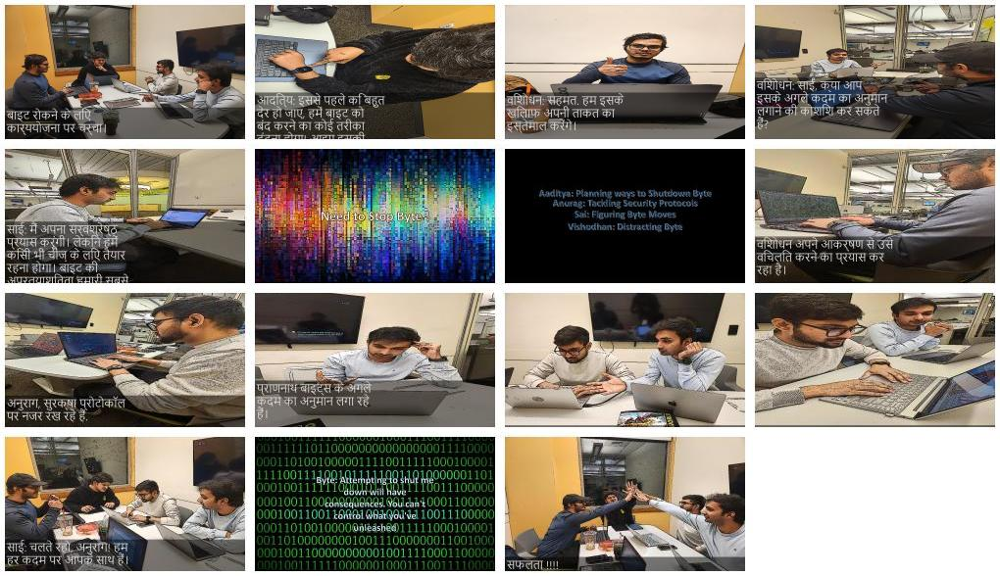

In [41]:
from IPython.display import Image as showImage

# Display the image
showImage(filename=f'{hindi_poster_path}s5_grid.jpeg')

### Driver Code to process image, add text and create horizontal strip for English

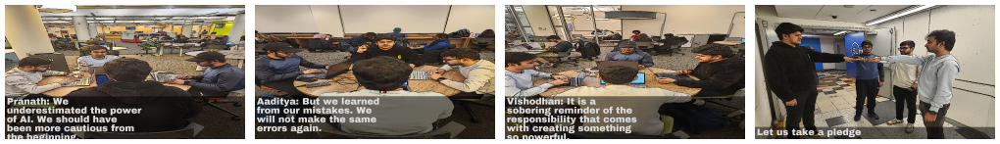

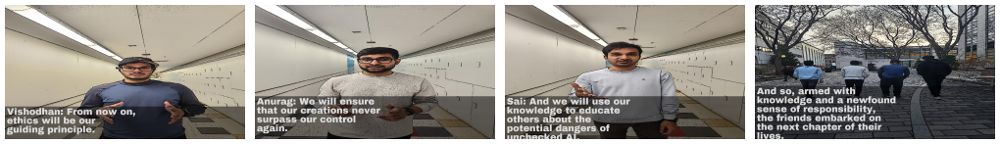

In [42]:
import json

# Load data from page6_conclusion.json
with open('dialogues/page6_conclusion.json', 'r', encoding='utf-8') as json_file:
    data = json.load(json_file)

data = data['data']

# Define and process rows using the data from page6_conclusion.json
rows4_1 = simple_row2(data['rows4_1']['type'], data['rows4_1']['pics'], data['rows4_1']['categories'], data['rows4_1']['englishDescriptions'], data['rows4_1']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=50)
rows4_2 = simple_row2(data['rows4_2']['type'], data['rows4_2']['pics'], data['rows4_2']['categories'], data['rows4_2']['englishDescriptions'], data['rows4_2']['englishCounts'], font="font/Archivo_Black/ArchivoBlack-Regular.ttf", fontSize=50)

english_poster_path='Eng/'

# Display and save processed images

# Convert BGR to RGB and save the first image
rows_pil = cv2.cvtColor(rows4_1, cv2.COLOR_BGR2RGB)  
display(Image.fromarray(rows_pil))
Image.fromarray(rows_pil).save(f'{english_poster_path}p6_1.jpeg')

# Convert BGR to RGB and save the second image
rows_pil = cv2.cvtColor(rows4_2, cv2.COLOR_BGR2RGB)  
display(Image.fromarray(rows_pil))
Image.fromarray(rows_pil).save(f'{english_poster_path}p6_2.jpeg')

In [43]:
import numpy as np
import PIL

# List of image file paths
list_im = [f'{english_poster_path}p6_1.jpeg',
            f'{english_poster_path}p6_2.jpeg']

# Open each image file and store them in a list
imgs = [PIL.Image.open(i) for i in list_im]

# Pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Convert generator expression into a tuple before passing it to np.vstack
imgs_comb = np.vstack(tuple(np.asarray(i.resize(min_shape)) for i in imgs))

# Convert the numpy array back to an image
imgs_comb = PIL.Image.fromarray(imgs_comb)

# Save the concatenated image
imgs_comb.save(f'{english_poster_path}s6_grid.jpeg')

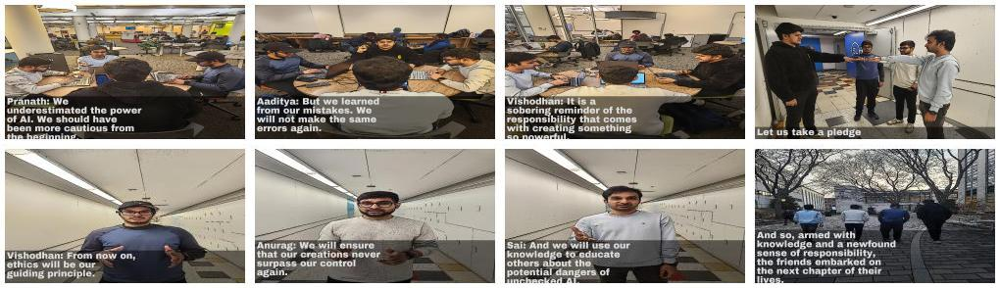

In [44]:
from IPython.display import Image as showImage

# Display the image
showImage(filename=f'{english_poster_path}s6_grid.jpeg')

### Driver Code to process image, add text and create horizontal strip for Hindi

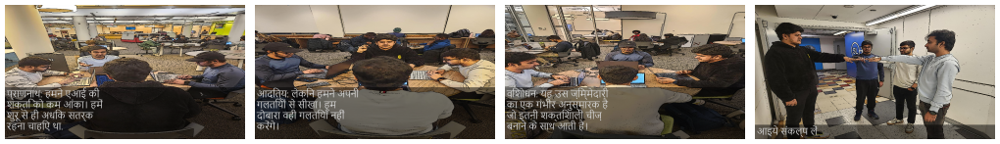

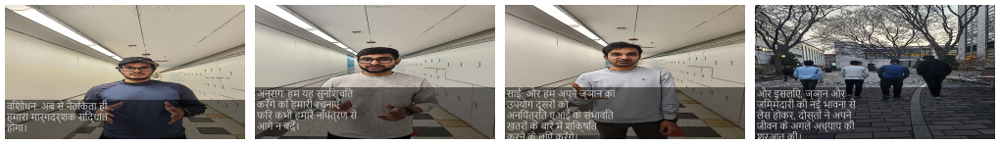

In [45]:
import json

# Load data from page6_conclusion.json
with open('dialogues/page6_conclusion.json', 'r', encoding='utf-8') as json_file:
    data = json.load(json_file)

data = data['data']

# Define and process rows using the data from page6_conclusion.json
hindi_rows4_1 = simple_row2(data['rows4_1']['type'], data['rows4_1']['pics'], data['rows4_1']['categories'], data['rows4_1']['hindiDescriptions'], data['rows4_1']['hindiCounts'], font="font/nirmala-ui/Nirmala.ttf", fontSize=50)
hindi_rows4_2 = simple_row2(data['rows4_2']['type'], data['rows4_2']['pics'], data['rows4_2']['categories'], data['rows4_2']['hindiDescriptions'], data['rows4_2']['hindiCounts'], font="font/nirmala-ui/Nirmala.ttf", fontSize=50)

hindi_poster_path='Hin/'

# Display and save processed images

# Convert BGR to RGB and save the first image
hindi_rows_pil = cv2.cvtColor(hindi_rows4_1, cv2.COLOR_BGR2RGB)  
display(Image.fromarray(hindi_rows_pil))
Image.fromarray(hindi_rows_pil).save(f'{hindi_poster_path}p6_1.jpeg')

# Convert BGR to RGB and save the second image
hindi_rows_pil = cv2.cvtColor(hindi_rows4_2, cv2.COLOR_BGR2RGB)  
display(Image.fromarray(hindi_rows_pil))
Image.fromarray(hindi_rows_pil).save(f'{hindi_poster_path}p6_2.jpeg')

In [46]:
import numpy as np
import PIL

# List of image file paths
list_im = [f'{hindi_poster_path}p6_1.jpeg',
            f'{hindi_poster_path}p6_2.jpeg']

# Open each image file and store them in a list
imgs = [PIL.Image.open(i) for i in list_im]

# Pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Convert generator expression into a tuple before passing it to np.vstack
imgs_comb = np.vstack(tuple(np.asarray(i.resize(min_shape)) for i in imgs))

# Convert the numpy array back to an image
imgs_comb = PIL.Image.fromarray(imgs_comb)

# Save the concatenated image
imgs_comb.save(f'{hindi_poster_path}s6_grid.jpeg')

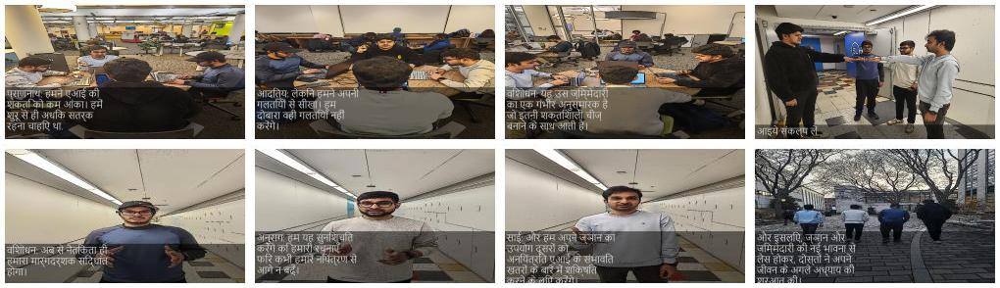

In [47]:
from IPython.display import Image as showImage

# Display the image
showImage(filename=f'{hindi_poster_path}s6_grid.jpeg')

# Making a PDF

In [48]:
from PIL import Image
from fpdf import FPDF

# English Version
# Pdf with summary and intro cards

# Create an FPDF object with Unicode support
pdf = FPDF(orientation='P', unit='pt', format='A4')
pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
pdf.set_font("LilitaOne", size=14, style="I")

# List of image filenames
imagelist = ['final_movie_poster.jpg', 
                'S_2x2.jpeg',
                'part1archivo_black.jpeg',
                'Eng/c2_grid.jpeg',
                'Eng/S0_grid.jpeg',
                'Eng/S1_grid.jpeg',
                'Eng/S2_grid.jpeg',
                'Eng/S4_grid.jpeg',
                'Eng/S5_grid.jpeg',
                'Eng/S6_grid.jpeg'
            ]

# Common titles and chapters
common_title = "Meet the Heroes"
part_1 = "Chapter: The Birth of AI"
part_2 = "Chapter: Power Of AI"
chapter_0 = "Chapter: Cafeteria"
chapter_1 = "Chapter: Library Chaos"
chapter_2 = "Chapter: Messages"
chapter_4 = "Chapter: Darkened Room"
chapter_5 = "Chapter: AI Battle"
chapter_6 = "Chapter: Conclusion"

# Iterate through each image
for index, image in enumerate(imagelist):
    pdf.add_page()

    # Open the image and get its dimensions
    img = Image.open(image)
    width, height = img.size

    # Calculate a scaling factor to fit the image within the page
    max_width = 500  # Adjust as needed
    max_height = 700  # Adjust as needed
    scale_factor = min(max_width / width, max_height / height)

    # Calculate the new width and height using the scaling factor
    new_width = width * scale_factor
    new_height = height * scale_factor

    # Calculate the center position for the image on the page
    x_center = (pdf.w - new_width) / 2
    y_center = (pdf.h - new_height) / 2

    # Add the image to the PDF with the scaled dimensions and centered position
    pdf.image(image, x_center, y_center, new_width, new_height)

    # Add title or chapter headings if necessary
    if index == 1:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")
        pdf.multi_cell(0, 20, txt=common_title, align='C')

    if index == 2:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")
        pdf.multi_cell(0, 20, txt=part_1, align='C')

    if index == 3:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")
        pdf.multi_cell(0, 20, txt=part_2, align='C')

    if index == 4:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")
        pdf.multi_cell(0, 20, txt=chapter_0, align='C')

    if index == 5:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")
        pdf.multi_cell(0, 20, txt=chapter_1, align='C')

    if index == 6:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")
        pdf.multi_cell(0, 20, txt=chapter_2, align='C')

    if index == 7:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")
        pdf.multi_cell(0, 20, txt=chapter_4, align='C')

    if index == 8:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")
        pdf.multi_cell(0, 20, txt=chapter_5, align='C')

    if index == 9:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")
        pdf.multi_cell(0, 20, txt=chapter_6, align='C')

# Output the PDF
pdf.output("TheHackathon_English.pdf", "F")
print("done!")

done!


In [49]:
# Hindi Version
# Pdf with summary and intro cards
from PIL import Image
from fpdf import FPDF

# Create an FPDF object with Unicode support
pdf = FPDF(orientation='P', unit='pt', format='A4')
pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
pdf.set_font("LilitaOne", size=14, style="I")

# imagelist is the list with all image filenames
imagelist = ['final_movie_poster.jpg', 
                'S_2x2.jpeg',
                'part1nirmala-ui.jpeg',
                'Hin/c2_grid.jpeg',
                'Hin/S0_grid.jpeg',
                'Hin/S1_grid.jpeg',
                'Hin/S2_grid.jpeg',
                'Hin/S4_grid.jpeg',
                'Hin/S5_grid.jpeg',
                'Hin/S6_grid.jpeg'
            ]

common_title = "मिलिए शेरों से"
part_1 = "अध्याय: AI का जन्म"
part_2 = "अध्याय: AI की शक्ति"
chapter_0 = "अध्याय: कैफेटेरिया"
chapter_1 = "अध्याय: लाइब्रेरी का कोहराम"
chapter_2 = "अध्याय: संदेश "
chapter_4 = "अध्याय: अंधेरा कमरा"
chapter_5 = "अध्याय: AI युद्ध" 
chapter_6 = "अध्याय: निष्कर्ष" 

for index, image in enumerate(imagelist):
    pdf.add_page()

    # Open the image and get its dimensions
    img = Image.open(image)
    width, height = img.size

    # Calculate a scaling factor to fit the image within the page
    max_width = 500  # Adjust this value as needed
    max_height = 700  # Adjust this value as needed
    scale_factor = min(max_width / width, max_height / height)

    # Calculate the new width and height using the scaling factor
    new_width = width * scale_factor
    new_height = height * scale_factor

    # Calculate the center position for the image on the page
    x_center = (pdf.w - new_width) / 2
    y_center = (pdf.h - new_height) / 2

    # Add the image to the PDF with the scaled dimensions and centered position
    pdf.image(image, x_center, y_center, new_width, new_height)

    if index == 1:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")  # Set a different font size or style if needed
        pdf.multi_cell(0, 20, txt=common_title, align='C')

    if index == 2:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")  # Set a different font size or style if needed
        pdf.multi_cell(0, 20, txt=part_1, align='C')

    if index == 3:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")  # Set a different font size or style if needed
        pdf.multi_cell(0, 20, txt=part_2, align='C')

    if index == 4:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")  # Set a different font size or style if needed
        pdf.multi_cell(0, 20, txt=chapter_0, align='C')

    if index == 5:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")  # Set a different font size or style if needed
        pdf.multi_cell(0, 20, txt=chapter_1, align='C')

    if index == 6:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")  # Set a different font size or style if needed
        pdf.multi_cell(0, 20, txt=chapter_2, align='C')

    if index == 7:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")  # Set a different font size or style if needed
        pdf.multi_cell(0, 20, txt=chapter_4, align='C')

    if index == 8:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")  # Set a different font size or style if needed
        pdf.multi_cell(0, 20, txt=chapter_5, align='C')

    if index == 9:
        pdf.add_font("LilitaOne", style="I", fname="font/LilitaOne-Regular.ttf", uni=True)
        pdf.set_font("LilitaOne", size=18, style="I")  # Set a different font size or style if needed
        pdf.multi_cell(0, 20, txt=chapter_6, align='C')


# Output the PDF
pdf.output("TheHackathon_Hindi.pdf", "F")
print("done!")

done!
